# About
According to statistics.. Nearly 800,000 people die because of suicide every year. That means that there is one person every 40 seconds. Suicide is a global phenomenon and occurs throughout the lifespan. There are indications that for each adult who died by suicide there may have been more than 20 others trying to commit suicide. So, the question was asked: 
"*Is there any interventions that can be done to help reduce these suicides & suicidal action?*"                              
In order to answer this question, we have gone through many data gathering processes that may help us in putting an indicator for causes that -mainly- cause suicidal deaths. In our gathering process, we focused on two main aspects that may help us in our goal: 
A) The Social aspect.
B) The individual aspect.
Our idea was to compare the number of suicides in different countries to the social aspects and get results (causes of suicides) by looking in correlation between data labels and suicides numbers and see if it can be considered as causations.   
Ofcourse, Individuals may have other causes than the social aspects and it -mostly- is caused by depression which happens due to: (Break ups- losing someone- ..etc). So in order to detect this, a small quiz is provided based on MADRS score to detect if there is a possibility for being depressed to help individuals and options are available for online help to people who may be exposed to depression.

# Resources
The data used in this project is compiled from three datasets:                                                                 
1.Suicide Rates of age groups in different countries along with Health Facilities and human resources
(*License Attribution-NonCommercial-ShareAlike 3.0 IGO (CC BY-NC-SA 3.0 IGO)*):
https://www.kaggle.com/twinkle0705/mental-health-and-suicide-rates?select=Crude+suicide+rates.csv                               
2.World happiness report 
(*Editors: John Helliwell, Richard Layard, Jeffrey D. Sachs, and Jan Emmanuel De Neve, Co-Editors; Lara Aknin, Haifang Huang and Shun Wang, Associate Editors; and Sharon Paculor, Production Editor* -  
*Citation:
Helliwell, John F., Richard Layard, Jeffrey Sachs, and Jan-Emmanuel De Neve, eds. 2020. World Happiness Report 2020. New York: Sustainable Development Solutions Network*):                                                                                   
https://www.kaggle.com/mathurinache/world-happiness-report                                                                    

# Pathway
My own pathway through this data will be passing by five steps:
#### 1 Asking questions
#### 2 Data wrangling
#### 3 EDA
#### 4 Draw conclusions
#### 5 Preprocessing & model building.

## 1st Asking questions
Since the question was proposed earlier & we have mainly gathered these data to answer it so we may now head into data to see how it can be used to answer our question:
##### Is there any interventions that can be done to help reduce these suicides & suicidal action?

## 2nd Data wrangling

### A) Gathering data, reading & merging essential labels.
My main aim in this step is to: read the data available & get a dataframe for an integrated dataset from all of the available datasets that we have gathered.

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
%matplotlib inline
sns.set(rc={'figure.figsize': [8, 8]}, font_scale=1.2)

Reading suicide rates, facilities and human resources dataset (rates are deined: per 100,000 population)

In [3]:
suicide_rates_age= pd.read_csv('Datasets\Suicide_rates-facilities&workers data\Crude suicide rates.csv')

In [4]:
#getting fisrt 5 of the dataset
suicide_rates_age.head(10)

,Country,Sex,80_above,70to79,60to69,50to59,40to49,30to39,20to29,10to19
0,Afghanistan,Both sexes,42.0,11.0,5.5,5.6,6.6,9.2,10.2,3.1
1,Afghanistan,Male,70.4,20.9,9.8,9.3,10.5,15.1,16.3,4.8
2,Afghanistan,Female,20.1,2.3,1.4,1.6,2.3,2.7,3.5,1.2
3,Albania,Both sexes,16.3,8.3,6.0,7.8,9.1,6.1,6.5,5.0
4,Albania,Male,23.2,11.9,8.1,11.4,13.5,8.8,6.3,3.1
5,Albania,Female,10.9,4.9,3.9,4.4,5.0,3.4,6.6,7.0
6,Algeria,Both sexes,9.4,5.6,4.2,4.1,4.7,5.3,4.2,1.3
7,Algeria,Male,12.7,8.4,6.2,6.2,7.0,7.9,6.2,1.6
8,Algeria,Female,6.4,3.0,2.2,2.0,2.4,2.6,2.1,1.0
9,Angola,Both sexes,63.5,42.1,23.8,14.8,7.0,5.4,6.6,2.6


*Note: The labels starting from "80_above" to the end of the dataframe, are labels of the age range and the numerical data it contains is the data of the suicidal rate to this age range.*

In [5]:
suicide_rates_facilities=pd.read_csv('Datasets\Suicide_rates-facilities&workers data\Facilities.csv')

In [6]:
#getting fisrt 5 of the dataset
suicide_rates_facilities.head(5)

,Country,Year,Mental _hospitals,health_units,outpatient _facilities,day _treatment,residential_facilities
0,Afghanistan,2016,0.003,0.012,0.006,NaN,NaN
1,Albania,2016,0.068,0.068,0.410,NaN,0.445
2,Algeria,2016,0.048,0.068,0.048,NaN,NaN
3,Angola,2016,0.011,NaN,NaN,NaN,0.014
4,Antigua and Barbuda,2016,1.001,NaN,NaN,NaN,NaN


In [7]:
suicide_rates_human= pd.read_csv('Datasets\Suicide_rates-facilities&workers data\Human Resources.csv')

In [8]:
#getting fisrt 5 of the dataset
suicide_rates_human.head(10)

,Country,Year,Psychiatrists,Nurses,Social_workers,Psychologists
0,Afghanistan,2016,0.231,0.098,NaN,0.296
1,Albania,2016,1.471,6.876,1.060,1.231
2,Angola,2016,0.057,0.660,0.022,0.179
3,Antigua and Barbuda,2016,1.001,7.005,4.003,NaN
4,Argentina,2016,21.705,NaN,NaN,222.572
5,Armenia,2016,3.840,11.245,0.274,0.788
6,Azerbaijan,2016,3.452,6.717,0.114,1.165
7,Bangladesh,2016,0.130,0.873,NaN,0.124
8,Belarus,2016,13.504,NaN,NaN,5.514
9,Belize,2016,1.392,3.340,NaN,1.113


We need to have a look at the join key('Country') first at the 3 datasets.

In [9]:
suicide_rates_age['Country'].value_counts()

Brazil          3
Comoros         3
South Africa    3
Guinea          3
Grenada         3
               ..
Mali            3
Burundi         3
Botswana        3
Vanuatu         3
Paraguay        3
Name: Country, Length: 183, dtype: int64

In [10]:
suicide_rates_facilities['Country'].value_counts().sum()

112

In [11]:
suicide_rates_human['Country'].value_counts().sum()

107

As we can see the number of values of countries in the 3 tables are different. This means that there is missing countries in the statistics of the: (facilities & human resources). Then we have to do outerjoin and the missing values(NULLs) can be solved then in the step of Assesing data and building intuitions. 

In [12]:
# We can divide the work by merging those dataframes above first. 
new_suicide_rates1=pd.merge(suicide_rates_age,suicide_rates_facilities,how='outer',on='Country')

In [13]:
new_suicide_rates1['Country'].value_counts()

Brazil          3
Albania         3
Algeria         3
South Africa    3
Guinea          3
               ..
Botswana        3
Paraguay        3
Monaco          1
Nauru           1
Cook Islands    1
Name: Country, Length: 186, dtype: int64

As we can observe above, the length that show the value counts of country, gives a length of 186; despite the fact that the dataset -which is (suicide_rates_age)- with the highest number of countries available only have 183 countries. This means that -Since we used the outer join, there is countries that exists in the second dataset & not in the first dataset. i.e: there is countries that provides statistics about facilities but don’t provide information about the suicides rates. In order to solve this problem we can neglect these 3 countries (The difference) as it will cause many problems in the "Data Assesing" step and we can do this by using left join based on the countries exists in (suicide_rates_age) dataset.

In [14]:
new_suicide_rates1=pd.merge(suicide_rates_age,suicide_rates_facilities,how='left',on='Country')

In [15]:
new_suicide_rates1['Country'].value_counts()

Brazil          3
Comoros         3
South Africa    3
Guinea          3
Grenada         3
               ..
Mali            3
Burundi         3
Botswana        3
Vanuatu         3
Paraguay        3
Name: Country, Length: 183, dtype: int64

As it ’s seen, know the problem is solved. And in order to avoid this problem again, we are going to merge the datasets to the dataset with the highest number of countries.

In [16]:
new_suicide_rates2=pd.merge(new_suicide_rates1,suicide_rates_human, how='left', on='Country')

In [17]:
# Continuing on the other 2 datasets available

Since the data available that shows statistics about the mental health state according to many aspects is only available -at the moment- for year 2016 so we will work with the dataset of happiness index of -only- year 2016.

In [18]:
#Importing happiness_dataset
happiness_df=pd.read_csv('Datasets/hapiness data 2016.csv')

In [19]:
happiness_df.head(5)

,Country,Region,Happiness Rank,Happiness Score,Lower Confidence Interval,Upper Confidence Interval,Economy (GDP per Capita),Family,Health (Life Expectancy),Freedom,Trust (Government Corruption),Generosity,Dystopia Residual
0,Denmark,Western Europe,1,7.526,7.460,7.592,1.44178,1.16374,0.79504,0.57941,0.44453,0.36171,2.73939
1,Switzerland,Western Europe,2,7.509,7.428,7.590,1.52733,1.14524,0.86303,0.58557,0.41203,0.28083,2.69463
2,Iceland,Western Europe,3,7.501,7.333,7.669,1.42666,1.18326,0.86733,0.56624,0.14975,0.47678,2.83137
3,Norway,Western Europe,4,7.498,7.421,7.575,1.57744,1.12690,0.79579,0.59609,0.35776,0.37895,2.66465
4,Finland,Western Europe,5,7.413,7.351,7.475,1.40598,1.13464,0.81091,0.57104,0.41004,0.25492,2.82596


There is an important note to be mentioned: The happiness rank and score of these counries have changed. Not by much values but these scores over 5 years have changed. But it doesn’t concern our purpose as our purpose was only to focus on the relation between the factors of happiness and its relation with happiness score and suicides ’ rates.

In [20]:
#Having a lock on the label('Country'), which will be used as a join key.
happiness_df['Country'].value_counts().sum()

157

As we can see here a problem have aroused. The number of values of countries is only 157 and the number of the countries in the merged above dataset is 183.But, since the second step intended to do after analysis of these data, is to build a model that uses a happiness index as a main label in the dataframe that will be used in building the suicides rates estimator model & since the happiness index depends on many aspects that is hard to provide for the rest of the countries exists in the (new_suicide_rates2) dataset, so we will head to inner join on merging in order -also- not to destroy the previous merges incase there were countries that doesn’t exist in the first merge.

In [21]:
Final_df=pd.merge(new_suicide_rates2,happiness_df, how='inner', on='Country')

In [22]:
Final_df

,Country,Sex,80_above,70to79,60to69,50to59,40to49,30to39,20to29,10to19,...,Happiness Score,Lower Confidence Interval,Upper Confidence Interval,Economy (GDP per Capita),Family,Health (Life Expectancy),Freedom,Trust (Government Corruption),Generosity,Dystopia Residual
0,Afghanistan,Both sexes,42.0,11.0,5.5,5.6,6.6,9.2,10.2,3.1,...,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558
1,Afghanistan,Male,70.4,20.9,9.8,9.3,10.5,15.1,16.3,4.8,...,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558
2,Afghanistan,Female,20.1,2.3,1.4,1.6,2.3,2.7,3.5,1.2,...,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558
3,Albania,Both sexes,16.3,8.3,6.0,7.8,9.1,6.1,6.5,5.0,...,4.655,4.546,4.764,0.95530,0.50163,0.73007,0.31866,0.05301,0.16840,1.92816
4,Albania,Male,23.2,11.9,8.1,11.4,13.5,8.8,6.3,3.1,...,4.655,4.546,4.764,0.95530,0.50163,0.73007,0.31866,0.05301,0.16840,1.92816
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
394,Zambia,Male,152.1,79.0,38.7,27.3,17.0,13.3,12.3,3.9,...,4.795,4.645,4.945,0.61202,0.63760,0.23573,0.42662,0.11479,0.17866,2.58991
395,Zambia,Female,31.2,26.4,16.0,11.2,6.9,4.6,4.2,1.6,...,4.795,4.645,4.945,0.61202,0.63760,0.23573,0.42662,0.11479,0.17866,2.58991
396,Zimbabwe,Both sexes,205.7,81.5,41.3,29.4,19.2,13.7,11.3,4.6,...,4.193,4.101,4.285,0.35041,0.71478,0.15950,0.25429,0.08582,0.18503,2.44270
397,Zimbabwe,Male,285.0,111.5,62.8,47.0,30.1,22.8,19.1,6.4,...,4.193,4.101,4.285,0.35041,0.71478,0.15950,0.25429,0.08582,0.18503,2.44270


The resulted dataframe is the dataframe that we will work on and go with it in our analysis process. Since this dataframe is a new of its kind, then it should be saved as it can be used by another analysts in many analysis processes with useful thoughts.

In [23]:
#Saving the dataframe to a csv file
Final_df.to_csv('suicide stats & social aspects.csv',index=False)

Now, we can go on the next part of the data wrangling process 

### B) Assesing & cleansing data  (Building intuitions)

My aim in this step is to assess the data & get it cleansed & free of any unnecessary labels as to be working & running smoothly.

In [24]:
#Importing the dataset
df=pd.read_csv('suicide stats & social aspects.csv')

In [25]:
df.head()

,Country,Sex,80_above,70to79,60to69,50to59,40to49,30to39,20to29,10to19,...,Happiness Score,Lower Confidence Interval,Upper Confidence Interval,Economy (GDP per Capita),Family,Health (Life Expectancy),Freedom,Trust (Government Corruption),Generosity,Dystopia Residual
0,Afghanistan,Both sexes,42.0,11.0,5.5,5.6,6.6,9.2,10.2,3.1,...,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558
1,Afghanistan,Male,70.4,20.9,9.8,9.3,10.5,15.1,16.3,4.8,...,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558
2,Afghanistan,Female,20.1,2.3,1.4,1.6,2.3,2.7,3.5,1.2,...,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558
3,Albania,Both sexes,16.3,8.3,6.0,7.8,9.1,6.1,6.5,5.0,...,4.655,4.546,4.764,0.95530,0.50163,0.73007,0.31866,0.05301,0.16840,1.92816
4,Albania,Male,23.2,11.9,8.1,11.4,13.5,8.8,6.3,3.1,...,4.655,4.546,4.764,0.95530,0.50163,0.73007,0.31866,0.05301,0.16840,1.92816


As it is observed, the data is not fully previewed on the screen. So, we have 2 options:                                       
*1.We can use "iloc" to show table rows below each other.*                                            
*2.We can "set_option" in pandas to show all of the columns and rows horizontally.*

In [26]:
df.iloc[:2,:15]

,Country,Sex,80_above,70to79,60to69,50to59,40to49,30to39,20to29,10to19,Year_x,Mental _hospitals,health_units,outpatient _facilities,day _treatment
0,Afghanistan,Both sexes,42.0,11.0,5.5,5.6,6.6,9.2,10.2,3.1,2016.0,0.003,0.012,0.006,NaN
1,Afghanistan,Male,70.4,20.9,9.8,9.3,10.5,15.1,16.3,4.8,2016.0,0.003,0.012,0.006,NaN


In [27]:
df.iloc[:2,15:27]

,residential_facilities,Year_y,Psychiatrists,Nurses,Social_workers,Psychologists,Region,Happiness Rank,Happiness Score,Lower Confidence Interval,Upper Confidence Interval,Economy (GDP per Capita)
0,NaN,2016.0,0.231,0.098,NaN,0.296,Southern Asia,154,3.36,3.288,3.432,0.38227
1,NaN,2016.0,0.231,0.098,NaN,0.296,Southern Asia,154,3.36,3.288,3.432,0.38227


In [28]:
df.iloc[:2,27:]

,Family,Health (Life Expectancy),Freedom,Trust (Government Corruption),Generosity,Dystopia Residual
0,0.11037,0.17344,0.1643,0.07112,0.31268,2.14558
1,0.11037,0.17344,0.1643,0.07112,0.31268,2.14558


In [29]:
#using pandas "set_option"
pd.set_option("display.max_rows", None, "display.max_columns", None)
df.head()

,Country,Sex,80_above,70to79,60to69,50to59,40to49,30to39,20to29,10to19,Year_x,Mental _hospitals,health_units,outpatient _facilities,day _treatment,residential_facilities,Year_y,Psychiatrists,Nurses,Social_workers,Psychologists,Region,Happiness Rank,Happiness Score,Lower Confidence Interval,Upper Confidence Interval,Economy (GDP per Capita),Family,Health (Life Expectancy),Freedom,Trust (Government Corruption),Generosity,Dystopia Residual
0,Afghanistan,Both sexes,42.0,11.0,5.5,5.6,6.6,9.2,10.2,3.1,2016.0,0.003,0.012,0.006,NaN,NaN,2016.0,0.231,0.098,NaN,0.296,Southern Asia,154,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558
1,Afghanistan,Male,70.4,20.9,9.8,9.3,10.5,15.1,16.3,4.8,2016.0,0.003,0.012,0.006,NaN,NaN,2016.0,0.231,0.098,NaN,0.296,Southern Asia,154,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558
2,Afghanistan,Female,20.1,2.3,1.4,1.6,2.3,2.7,3.5,1.2,2016.0,0.003,0.012,0.006,NaN,NaN,2016.0,0.231,0.098,NaN,0.296,Southern Asia,154,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558
3,Albania,Both sexes,16.3,8.3,6.0,7.8,9.1,6.1,6.5,5.0,2016.0,0.068,0.068,0.410,NaN,0.445,2016.0,1.471,6.876,1.06,1.231,Central and Eastern Europe,109,4.655,4.546,4.764,0.95530,0.50163,0.73007,0.31866,0.05301,0.16840,1.92816
4,Albania,Male,23.2,11.9,8.1,11.4,13.5,8.8,6.3,3.1,2016.0,0.068,0.068,0.410,NaN,0.445,2016.0,1.471,6.876,1.06,1.231,Central and Eastern Europe,109,4.655,4.546,4.764,0.95530,0.50163,0.73007,0.31866,0.05301,0.16840,1.92816


In [30]:
#Getting info about data 
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 399 entries, 0 to 398
Data columns (total 33 columns):
Country                          399 non-null object
Sex                              399 non-null object
 80_above                        399 non-null float64
 70to79                          399 non-null float64
 60to69                          399 non-null float64
 50to59                          399 non-null float64
 40to49                          399 non-null float64
 30to39                          399 non-null float64
 20to29                          399 non-null float64
 10to19                          399 non-null float64
Year_x                           258 non-null float64
Mental _hospitals                216 non-null float64
health_units                     246 non-null float64
outpatient _facilities           225 non-null float64
day _treatment                   123 non-null float64
residential_facilities           114 non-null float64
Year_y                           

Many things can be observed from info() function results above:                                                                 
*1. Our data is composed of 37 columns of 399 entry*                                                                           
*2. 'Year_x','Mental _hospitals', 'health_units', 'outpatient _facilities','day _treatment', 'residential_facilities','Year_y', 'Psychiatrists','Nurses', 'Social_workers', 'Psychologists' labels have null values*                                           
*3.Dates columns are not necessary and can be dropped*                                                                         
*4.These labels: 'Probability of dying to NCDs(b)', 'Probability of dying to NCDs(m)','Probability of dying to NCDs(f)' datatype is needed to be dealt with & also needs some feature extraction*

In [31]:
df.describe()

,80_above,70to79,60to69,50to59,40to49,30to39,20to29,10to19,Year_x,Mental _hospitals,health_units,outpatient _facilities,day _treatment,residential_facilities,Year_y,Psychiatrists,Nurses,Social_workers,Psychologists,Happiness Rank,Happiness Score,Lower Confidence Interval,Upper Confidence Interval,Economy (GDP per Capita),Family,Health (Life Expectancy),Freedom,Trust (Government Corruption),Generosity,Dystopia Residual
count,399.000000,399.000000,399.000000,399.000000,399.000000,399.000000,399.000000,399.000000,258.0,216.000000,246.000000,225.000000,123.000000,114.000000,243.0,243.000000,204.000000,144.000000,198.000000,399.000000,399.000000,399.000000,399.000000,399.000000,399.000000,399.000000,399.000000,399.000000,399.000000,399.000000
mean,41.999248,25.681704,17.188221,14.947619,12.404762,11.014536,10.313033,4.046115,2016.0,0.234528,0.292988,1.303573,1.070439,0.673053,2016.0,4.615691,12.565721,2.612167,11.078015,78.977444,5.384925,5.285609,5.484241,0.953101,0.795871,0.552349,0.375772,0.140136,0.238197,2.329489
std,43.261210,24.125994,13.714625,12.062311,10.361916,9.400398,8.454132,3.103917,0.0,0.998328,0.621745,2.243524,2.839649,1.397522,0.0,7.864679,23.996934,11.066021,34.511489,46.012310,1.156924,1.164160,1.150864,0.414187,0.272450,0.228948,0.146374,0.114079,0.132412,0.524581
min,0.000000,0.000000,0.000000,0.000000,0.900000,0.600000,0.900000,0.000000,2016.0,0.001000,0.006000,0.006000,0.002000,0.006000,2016.0,0.007000,0.000000,0.006000,0.008000,1.000000,2.905000,2.732000,3.078000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.916810
25%,13.100000,8.350000,6.600000,6.200000,5.300000,4.550000,4.300000,1.800000,2016.0,0.017750,0.033000,0.112000,0.020000,0.027000,2016.0,0.207000,0.615750,0.055500,0.256000,39.000000,4.395000,4.322000,4.463000,0.630690,0.637600,0.371090,0.267550,0.061260,0.150110,2.044970
50%,25.800000,16.800000,12.900000,11.900000,9.600000,8.200000,7.600000,3.100000,2016.0,0.032000,0.078000,0.410000,0.101000,0.063500,2016.0,1.392000,3.469000,0.297500,1.139000,80.000000,5.303000,5.226000,5.398000,1.027870,0.862160,0.596000,0.402120,0.106130,0.216740,2.281360
75%,55.550000,35.800000,23.900000,20.850000,16.850000,14.300000,13.500000,5.300000,2016.0,0.127750,0.307000,1.491000,0.716000,0.305000,2016.0,5.665000,10.806250,0.892000,5.514000,119.000000,6.324000,6.178000,6.435000,1.269200,1.021690,0.717230,0.487700,0.179140,0.304520,2.614820
max,285.000000,121.000000,78.500000,85.400000,75.000000,66.000000,53.500000,21.200000,2016.0,8.314000,4.542000,14.820000,17.176000,6.178000,2016.0,48.040000,150.251000,76.957000,222.572000,157.000000,7.526000,7.460000,7.669000,1.824270,1.183260,0.947190,0.608480,0.505210,0.819710,3.837720


From descriptive statistics for our dataframe, there are many things to be noticed:
1. On a strange way, the mean suicide rate of '80_above' age range -which is 41.99/100k population- is the highest and the mean continues to decrease as the age range goes down
2. Only the age ranges ('40to49','30to39','20to29') 'Working age ranges' have minimum rates of suicides that doesn’t equal zero and this means that these age ranges needs a more focus on it.
3. I think that we need to add columns/ labels that descripe the population of the age ranges to help in explain (point 1)
4. The mean of the world happiness score is above average by a little. (rated from 0:10)
5. A strange note as well, the minimum value for gdp(gross domestic product)-which is calculated by dividing the net national income over the population- is zero.

In order to solve the mystery on the first point we had to head to the resource of the suicide rates/ age range which is integrated from our first imported dataset(suicide_rates_age). we have found that the suicide rates of all age ranges are calculated to a specific pop (/100k) for a statistical purposes but this led & may lead in our further analysis to a misleading percentages of suicide rates. So, in order to solve this point, we can compare the suicide rates to the true population of each age range in each country. This required us to get the dataset of the population of each country to each age range. By heading to united nations website we got that dataset from the following resource: https://population.un.org/wpp/DataQuery/             

In [32]:
#Importing the population dataset
df_population=pd.read_excel('Datasets/PopulationAgeSex-20210705101251.xlsx',sheet_name='Data',)
df_population

,Population by age and sex (thousands),Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23
0,ISO 3166-1 numeric code,Location,Time,Sex,Note,10-14,15-19,20-24,25-29,30-34,35-39,40-44,45-49,50-54,55-59,60-64,65-69,70-74,75-79,80-84,85-89,90-94,95-99,100+
1,900,World,2016,Both sexes combined,NaN,620159,602836,595624,611071,562654,506060,488992,463076,411689,348422,300921,226344,158026,115967,73206,38096,14441,3185,443
2,900,World,2016,Female,NaN,299265,291390,288765,298416,276400,249731,242002,230583,205984,176079,154155,118573,84884,65061,43190,24102,9940,2364,352
3,900,World,2016,Male,NaN,320894,311446,306859,312654,286254,256329,246990,232492,205705,172343,146766,107771,73142,50906,30015,13995,4501,822,91
4,1803,UN development groups,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,901,More developed regions,2016,Both sexes combined,b,67974,69014,76529,84881,86628,85357,86661,85930,88487,85451,78274,69050,52089,43668,31085,19376,8475,1917,256
6,901,More developed regions,2016,Female,b,33127,33661,37352,41693,42908,42629,43415,43189,44904,44122,41334,37042,28760,25389,18956,12734,6072,1486,214
7,901,More developed regions,2016,Male,b,34847,35353,39177,43187,43720,42728,43246,42741,43582,41329,36940,32007,23329,18279,12129,6642,2404,430,42
8,902,Less developed regions,2016,Both sexes combined,c,552184,533822,519095,526190,476026,420703,402331,377145,323202,262971,222648,157294,105937,72298,42120,18720,5966,1269,187
9,902,Less developed regions,2016,Female,c,266138,257729,251413,256723,233492,207102,198588,187394,161080,131957,112821,81531,56124,39672,24234,11367,3868,877,137


In [33]:
#Modifying the label names to be the names of the first record 
df_population.set_axis(list(df_population.iloc[0]),axis=1,inplace=True)
df_population.drop(0,inplace=True)
#Resetting the index
df_population.reset_index(drop=True,inplace=True)

In [34]:
df_population

,ISO 3166-1 numeric code,Location,Time,Sex,Note,10-14,15-19,20-24,25-29,30-34,35-39,40-44,45-49,50-54,55-59,60-64,65-69,70-74,75-79,80-84,85-89,90-94,95-99,100+
0,900,World,2016,Both sexes combined,NaN,620159,602836,595624,611071,562654,506060,488992,463076,411689,348422,300921,226344,158026,115967,73206,38096,14441,3185,443
1,900,World,2016,Female,NaN,299265,291390,288765,298416,276400,249731,242002,230583,205984,176079,154155,118573,84884,65061,43190,24102,9940,2364,352
2,900,World,2016,Male,NaN,320894,311446,306859,312654,286254,256329,246990,232492,205705,172343,146766,107771,73142,50906,30015,13995,4501,822,91
3,1803,UN development groups,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,901,More developed regions,2016,Both sexes combined,b,67974,69014,76529,84881,86628,85357,86661,85930,88487,85451,78274,69050,52089,43668,31085,19376,8475,1917,256
5,901,More developed regions,2016,Female,b,33127,33661,37352,41693,42908,42629,43415,43189,44904,44122,41334,37042,28760,25389,18956,12734,6072,1486,214
6,901,More developed regions,2016,Male,b,34847,35353,39177,43187,43720,42728,43246,42741,43582,41329,36940,32007,23329,18279,12129,6642,2404,430,42
7,902,Less developed regions,2016,Both sexes combined,c,552184,533822,519095,526190,476026,420703,402331,377145,323202,262971,222648,157294,105937,72298,42120,18720,5966,1269,187
8,902,Less developed regions,2016,Female,c,266138,257729,251413,256723,233492,207102,198588,187394,161080,131957,112821,81531,56124,39672,24234,11367,3868,877,137
9,902,Less developed regions,2016,Male,c,286046,276093,267682,269467,242533,213602,203743,189751,162123,131014,109827,75764,49813,32627,17886,7353,2098,391,49


In order not to make our integrated dataset too large, we will go on assesing, cleansing & some feature engineering on this table on its own. Then, it would be merged with our dataframe. 

The records that shows the statistics of population to other criterion rather than countries will be dropped as they are not needed because our integrated dataset only has the country as a criterion for the location. 

In [35]:
#Dropping non-needed rows
df_population.drop(df_population.index[0:70],inplace=True)
df_population.reset_index(drop=True,inplace=True)
df_population

,ISO 3166-1 numeric code,Location,Time,Sex,Note,10-14,15-19,20-24,25-29,30-34,35-39,40-44,45-49,50-54,55-59,60-64,65-69,70-74,75-79,80-84,85-89,90-94,95-99,100+
0,108,Burundi,2016,Both sexes combined,NaN,1280,1077,1012,922,726,500,331,274,249,224,169,95,60,38,21,8,2,0,0
1,108,Burundi,2016,Female,NaN,639,539,509,465,366,253,172,147,132,117,88,52,34,23,12,5,1,0,0
2,108,Burundi,2016,Male,NaN,641,538,503,457,360,247,159,127,117,107,80,44,26,16,8,3,1,0,0
3,174,Comoros,2016,Both sexes combined,NaN,93,83,74,67,57,46,37,30,25,20,15,10,7,4,2,1,0,0,0
4,174,Comoros,2016,Female,NaN,46,41,37,33,28,23,18,15,13,10,8,5,4,2,1,0,0,0,0
5,174,Comoros,2016,Male,NaN,47,42,38,34,29,23,19,15,12,10,7,5,3,2,1,0,0,0,0
6,262,Djibouti,2016,Both sexes combined,NaN,90,90,87,87,79,70,58,45,38,30,21,17,12,7,4,1,0,0,0
7,262,Djibouti,2016,Female,NaN,41,41,40,41,38,33,26,22,18,14,10,8,6,4,2,1,0,0,0
8,262,Djibouti,2016,Male,NaN,50,49,47,46,41,37,31,24,20,15,10,8,6,3,2,1,0,0,0
9,232,Eritrea,2016,Both sexes combined,NaN,419,313,304,302,235,166,150,100,90,78,69,60,43,27,13,5,1,0,0


In [36]:
df_population.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 687 entries, 0 to 686
Data columns (total 24 columns):
ISO 3166-1 numeric code    687 non-null object
Location                   687 non-null object
Time                       687 non-null object
Sex                        687 non-null object
Note                       114 non-null object
10-14                      687 non-null object
15-19                      687 non-null object
20-24                      687 non-null object
25-29                      687 non-null object
30-34                      687 non-null object
35-39                      687 non-null object
40-44                      687 non-null object
45-49                      687 non-null object
50-54                      687 non-null object
55-59                      687 non-null object
60-64                      687 non-null object
65-69                      687 non-null object
70-74                      687 non-null object
75-79                      687 non-null object
80

As it is seen from above:
1. The values that is needed from this dataset is of the same number of records while the columns that have an extra or less records will be dropped as they are with no need.
2. The data types of the age ranges are needed to be modified to int64 dtype for the arithmetic purposes.

In [37]:
#Dropping non-needed columns
df_population.drop(columns=['ISO 3166-1 numeric code','Time','Note'],inplace=True)

In [38]:
#Seeing wrong dtypes
df_population.dtypes

Location    object
Sex         object
10-14       object
15-19       object
20-24       object
25-29       object
30-34       object
35-39       object
40-44       object
45-49       object
50-54       object
55-59       object
60-64       object
65-69       object
70-74       object
75-79       object
80-84       object
85-89       object
90-94       object
95-99       object
100+        object
dtype: object

In [39]:
#Fixing dtypes
age_ranges=list(df_population.columns)[2:]
for i in age_ranges:
    df_population[i]=df_population[i].astype('int')

In [40]:
df_population.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 687 entries, 0 to 686
Data columns (total 21 columns):
Location    687 non-null object
Sex         687 non-null object
10-14       687 non-null int32
15-19       687 non-null int32
20-24       687 non-null int32
25-29       687 non-null int32
30-34       687 non-null int32
35-39       687 non-null int32
40-44       687 non-null int32
45-49       687 non-null int32
50-54       687 non-null int32
55-59       687 non-null int32
60-64       687 non-null int32
65-69       687 non-null int32
70-74       687 non-null int32
75-79       687 non-null int32
80-84       687 non-null int32
85-89       687 non-null int32
90-94       687 non-null int32
95-99       687 non-null int32
100+        687 non-null int32
dtypes: int32(19), object(2)
memory usage: 61.8+ KB


The problem is solved.

Fast Data assesing & cleansing was done for this dataset. There are two thing that are needed to be fixed. As it is seen:
1. The label 'Location' which prefaces the label 'Country' in df is not ordered. 
2. the age ranges in this dataset are for every 5 years but in our integrated dataset are for every 10 years. So, we need to merge every two consecutive columns that describe the age range and give the labels new names.  

In [41]:
#Ordering the 'Location'
df_population.sort_values(by=['Location','Sex'])

,Location,Sex,10-14,15-19,20-24,25-29,30-34,35-39,40-44,45-49,50-54,55-59,60-64,65-69,70-74,75-79,80-84,85-89,90-94,95-99,100+
618,Albania,Both sexes combined,194,231,254,241,183,157,170,184,204,197,159,122,103,78,46,20,5,1,0
619,Albania,Female,91,112,121,110,83,77,90,96,104,100,81,62,53,40,24,12,3,0,0
620,Albania,Male,104,119,133,131,100,80,81,89,100,97,78,60,50,38,21,8,2,0,0
657,Austria,Both sexes combined,419,454,548,583,603,556,587,698,713,622,490,437,433,335,220,145,70,12,1
658,Austria,Female,204,220,267,287,299,277,294,348,354,314,253,231,235,189,131,95,53,10,1
659,Austria,Male,215,233,281,296,304,279,293,350,359,308,237,207,198,147,89,50,18,2,0
549,Belarus,Both sexes combined,452,437,574,760,753,682,653,619,714,722,609,433,281,301,196,112,35,4,0
550,Belarus,Female,220,213,279,370,372,343,337,326,381,397,352,261,183,212,145,87,29,4,0
551,Belarus,Male,232,224,295,390,381,339,316,293,333,325,257,171,98,89,51,25,6,0,0
660,Belgium,Both sexes combined,631,629,691,720,740,742,759,792,817,771,676,612,448,388,323,205,92,16,2


The code is alright. so it means that there is a logical error. We may have a closer look at 'Location' column.

In [42]:
df_population['Location']

0                                                Burundi
1                                                Burundi
2                                                Burundi
3                                                Comoros
4                                                Comoros
5                                                Comoros
6                                               Djibouti
7                                               Djibouti
8                                               Djibouti
9                                                Eritrea
10                                               Eritrea
11                                               Eritrea
12                                              Ethiopia
13                                              Ethiopia
14                                              Ethiopia
15                                                 Kenya
16                                                 Kenya
17                             

There is no obvious problem.

So I thought in turning the column into a list, sorting it after using 'value_counts()' function & multiplicate each returned value from 'value_counts()' by 3. But as turning the column into a list the problem was obvious. There is leading spaces in some data valuyes in the 'Location' column. so it’s needed to be fixed first.

In [43]:
df_population['Location']=df_population['Location'].str.strip()

In [44]:
df_population.sort_values(by=['Location','Sex'],inplace=True)
df_population.reset_index(drop=True,inplace=True)

In [45]:
#merging the age ranges
list_age_ranges=['10-19','20-29','30-39','40-49','50-59','60-69','70-79','80-']
list_age_pop=list(df_population.columns[2:])
counter=0
counter_old_ranges=0
while(counter<len(list_age_ranges)):
    if(counter<len(list_age_ranges)-1):
        df_population[list_age_ranges[counter]]=df_population[list_age_pop[counter_old_ranges]]+df_population[list_age_pop[counter_old_ranges+1]]
    else:
        df_population[list_age_ranges[counter]]=0
        for i in list_age_pop[14:]:
            df_population[list_age_ranges[counter]]+=df_population[i]
    counter+=1
    counter_old_ranges+=2

In [46]:
#Dropping non-needed columns after merging
df_population.drop(columns=list(df_population.columns)[2:21],inplace=True)

In [47]:
df_population

,Location,Sex,10-19,20-29,30-39,40-49,50-59,60-69,70-79,80-
0,Afghanistan,Both sexes combined,9023,6013,3959,2532,1595,935,396,93
1,Afghanistan,Female,4398,2880,1888,1217,780,483,211,52
2,Afghanistan,Male,4625,3133,2070,1316,815,452,184,41
3,Albania,Both sexes combined,425,495,340,354,401,281,181,72
4,Albania,Female,203,231,160,186,204,143,93,39
5,Albania,Male,223,264,180,170,197,138,88,31
6,Algeria,Both sexes combined,5972,7247,6799,4721,3335,2121,1094,484
7,Algeria,Female,2923,3578,3382,2365,1657,1038,575,254
8,Algeria,Male,3048,3669,3417,2356,1678,1083,520,229
9,Angola,Both sexes combined,6736,4686,3183,2035,1312,656,297,76


Since the df_population dataset is now alright, we need to go on 2 steps to get the best of it:
1. Merging the two datasets (df & df_population)
2. Solving arthimetically the problem of suicides_rates.

##### Going on some quick fixes for the 2 datasets

In [48]:
#Giving the 'location' label of df_population & 'Country' label of df
df_population.rename(columns={'Location': 'Country'},inplace=True)
# changing the equal values of sex to be of the same name
df_population["Sex"].replace({"Both sexes combined": "Both sexes"},inplace=True)

In [49]:
#Removing extra spaces
df['Country']=df['Country'].str.strip()
df['Sex']=df['Sex'].str.strip()
df_population['Sex']=df_population['Sex'].str.strip()

In [50]:
#Reordering the df dataset
df.sort_values(by=['Country','Sex'],inplace=True)
df.reset_index(drop=True,inplace=True)

###### Merging the 2 datasets

In [51]:
#Merging the two datasets
df=pd.merge(df,df_population, how='left', on=['Country','Sex'])

In [52]:
df.head()

,Country,Sex,80_above,70to79,60to69,50to59,40to49,30to39,20to29,10to19,Year_x,Mental _hospitals,health_units,outpatient _facilities,day _treatment,residential_facilities,Year_y,Psychiatrists,Nurses,Social_workers,Psychologists,Region,Happiness Rank,Happiness Score,Lower Confidence Interval,Upper Confidence Interval,Economy (GDP per Capita),Family,Health (Life Expectancy),Freedom,Trust (Government Corruption),Generosity,Dystopia Residual,10-19,20-29,30-39,40-49,50-59,60-69,70-79,80-
0,Afghanistan,Both sexes,42.0,11.0,5.5,5.6,6.6,9.2,10.2,3.1,2016.0,0.003,0.012,0.006,NaN,NaN,2016.0,0.231,0.098,NaN,0.296,Southern Asia,154,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558,9023,6013,3959,2532,1595,935,396,93
1,Afghanistan,Female,20.1,2.3,1.4,1.6,2.3,2.7,3.5,1.2,2016.0,0.003,0.012,0.006,NaN,NaN,2016.0,0.231,0.098,NaN,0.296,Southern Asia,154,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558,4398,2880,1888,1217,780,483,211,52
2,Afghanistan,Male,70.4,20.9,9.8,9.3,10.5,15.1,16.3,4.8,2016.0,0.003,0.012,0.006,NaN,NaN,2016.0,0.231,0.098,NaN,0.296,Southern Asia,154,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558,4625,3133,2070,1316,815,452,184,41
3,Albania,Both sexes,16.3,8.3,6.0,7.8,9.1,6.1,6.5,5.0,2016.0,0.068,0.068,0.410,NaN,0.445,2016.0,1.471,6.876,1.06,1.231,Central and Eastern Europe,109,4.655,4.546,4.764,0.95530,0.50163,0.73007,0.31866,0.05301,0.16840,1.92816,425,495,340,354,401,281,181,72
4,Albania,Female,10.9,4.9,3.9,4.4,5.0,3.4,6.6,7.0,2016.0,0.068,0.068,0.410,NaN,0.445,2016.0,1.471,6.876,1.06,1.231,Central and Eastern Europe,109,4.655,4.546,4.764,0.95530,0.50163,0.73007,0.31866,0.05301,0.16840,1.92816,203,231,160,186,204,143,93,39


###### Solving the problem of suicide rates

In [53]:
df.columns[33:]

Index(['10-19', '20-29', '30-39', '40-49', '50-59', '60-69', '70-79', '80-'], dtype='object')

In [54]:
lst_suic_rate=list(df.columns[2:10])
lst_age=list(df.columns[33:])
# To match age ranges with each other since they are reversed.
lst_age.reverse()
counter=0
for i in lst_suic_rate:
    df[i]=df[lst_age[counter]]*df[i]/100000
    counter+=1

In [55]:
df

,Country,Sex,80_above,70to79,60to69,50to59,40to49,30to39,20to29,10to19,Year_x,Mental _hospitals,health_units,outpatient _facilities,day _treatment,residential_facilities,Year_y,Psychiatrists,Nurses,Social_workers,Psychologists,Region,Happiness Rank,Happiness Score,Lower Confidence Interval,Upper Confidence Interval,Economy (GDP per Capita),Family,Health (Life Expectancy),Freedom,Trust (Government Corruption),Generosity,Dystopia Residual,10-19,20-29,30-39,40-49,50-59,60-69,70-79,80-
0,Afghanistan,Both sexes,0.039060,0.043560,0.051425,0.089320,0.167112,0.364228,0.613326,0.279713,2016.0,0.003,0.012,0.006,NaN,NaN,2016.0,0.231,0.098,NaN,0.296,Southern Asia,154,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558,9023,6013,3959,2532,1595,935,396,93
1,Afghanistan,Female,0.010452,0.004853,0.006762,0.012480,0.027991,0.050976,0.100800,0.052776,2016.0,0.003,0.012,0.006,NaN,NaN,2016.0,0.231,0.098,NaN,0.296,Southern Asia,154,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558,4398,2880,1888,1217,780,483,211,52
2,Afghanistan,Male,0.028864,0.038456,0.044296,0.075795,0.138180,0.312570,0.510679,0.222000,2016.0,0.003,0.012,0.006,NaN,NaN,2016.0,0.231,0.098,NaN,0.296,Southern Asia,154,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558,4625,3133,2070,1316,815,452,184,41
3,Albania,Both sexes,0.011736,0.015023,0.016860,0.031278,0.032214,0.020740,0.032175,0.021250,2016.0,0.068,0.068,0.410,NaN,0.445,2016.0,1.471,6.876,1.060,1.231,Central and Eastern Europe,109,4.655,4.546,4.764,0.95530,0.50163,0.73007,0.31866,0.05301,0.16840,1.92816,425,495,340,354,401,281,181,72
4,Albania,Female,0.004251,0.004557,0.005577,0.008976,0.009300,0.005440,0.015246,0.014210,2016.0,0.068,0.068,0.410,NaN,0.445,2016.0,1.471,6.876,1.060,1.231,Central and Eastern Europe,109,4.655,4.546,4.764,0.95530,0.50163,0.73007,0.31866,0.05301,0.16840,1.92816,203,231,160,186,204,143,93,39
5,Albania,Male,0.007192,0.010472,0.011178,0.022458,0.022950,0.015840,0.016632,0.006913,2016.0,0.068,0.068,0.410,NaN,0.445,2016.0,1.471,6.876,1.060,1.231,Central and Eastern Europe,109,4.655,4.546,4.764,0.95530,0.50163,0.73007,0.31866,0.05301,0.16840,1.92816,223,264,180,170,197,138,88,31
6,Algeria,Both sexes,0.045496,0.061264,0.089082,0.136735,0.221887,0.360347,0.304374,0.077636,2016.0,0.048,0.068,0.048,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Middle East and Northern Africa,38,6.355,6.227,6.483,1.05266,0.83309,0.61804,0.21006,0.16157,0.07044,3.40904,5972,7247,6799,4721,3335,2121,1094,484
7,Algeria,Female,0.016256,0.017250,0.022836,0.033140,0.056760,0.087932,0.075138,0.029230,2016.0,0.048,0.068,0.048,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Middle East and Northern Africa,38,6.355,6.227,6.483,1.05266,0.83309,0.61804,0.21006,0.16157,0.07044,3.40904,2923,3578,3382,2365,1657,1038,575,254
8,Algeria,Male,0.029083,0.043680,0.067146,0.104036,0.164920,0.269943,0.227478,0.048768,2016.0,0.048,0.068,0.048,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Middle East and Northern Africa,38,6.355,6.227,6.483,1.05266,0.83309,0.61804,0.21006,0.16157,0.07044,3.40904,3048,3669,3417,2356,1678,1083,520,229
9,Angola,Both sexes,0.048260,0.125037,0.156128,0.194176,0.142450,0.171882,0.309276,0.175136,2016.0,0.011,NaN,NaN,NaN,0.014,2016.0,0.057,0.660,0.022,0.179,Sub-Saharan Africa,141,3.866,3.753,3.979,0.84731,0.66366,0.04991,0.00589,0.08434,0.12071,2.09459,6736,4686,3183,2035,1312,656,297,76


The last thing that can be got out of this data to be of perfect use is to get the population as to check if there is a relation between the jam population & the suicide rates. We will get the population by summing up all of the age ranges. 

In [56]:
#Summing up the gae ranges
df['population']=df.iloc[:,33:].sum(axis=1)

In [57]:
df.head()

,Country,Sex,80_above,70to79,60to69,50to59,40to49,30to39,20to29,10to19,Year_x,Mental _hospitals,health_units,outpatient _facilities,day _treatment,residential_facilities,Year_y,Psychiatrists,Nurses,Social_workers,Psychologists,Region,Happiness Rank,Happiness Score,Lower Confidence Interval,Upper Confidence Interval,Economy (GDP per Capita),Family,Health (Life Expectancy),Freedom,Trust (Government Corruption),Generosity,Dystopia Residual,10-19,20-29,30-39,40-49,50-59,60-69,70-79,80-,population
0,Afghanistan,Both sexes,0.039060,0.043560,0.051425,0.089320,0.167112,0.364228,0.613326,0.279713,2016.0,0.003,0.012,0.006,NaN,NaN,2016.0,0.231,0.098,NaN,0.296,Southern Asia,154,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558,9023,6013,3959,2532,1595,935,396,93,24546
1,Afghanistan,Female,0.010452,0.004853,0.006762,0.012480,0.027991,0.050976,0.100800,0.052776,2016.0,0.003,0.012,0.006,NaN,NaN,2016.0,0.231,0.098,NaN,0.296,Southern Asia,154,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558,4398,2880,1888,1217,780,483,211,52,11909
2,Afghanistan,Male,0.028864,0.038456,0.044296,0.075795,0.138180,0.312570,0.510679,0.222000,2016.0,0.003,0.012,0.006,NaN,NaN,2016.0,0.231,0.098,NaN,0.296,Southern Asia,154,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558,4625,3133,2070,1316,815,452,184,41,12636
3,Albania,Both sexes,0.011736,0.015023,0.016860,0.031278,0.032214,0.020740,0.032175,0.021250,2016.0,0.068,0.068,0.410,NaN,0.445,2016.0,1.471,6.876,1.06,1.231,Central and Eastern Europe,109,4.655,4.546,4.764,0.95530,0.50163,0.73007,0.31866,0.05301,0.16840,1.92816,425,495,340,354,401,281,181,72,2549
4,Albania,Female,0.004251,0.004557,0.005577,0.008976,0.009300,0.005440,0.015246,0.014210,2016.0,0.068,0.068,0.410,NaN,0.445,2016.0,1.471,6.876,1.06,1.231,Central and Eastern Europe,109,4.655,4.546,4.764,0.95530,0.50163,0.73007,0.31866,0.05301,0.16840,1.92816,203,231,160,186,204,143,93,39,1259


Since we got the population, then there is no need for the population of each age range. So, we can drop the age ranges.

In [58]:
#Drooping age ranges
df.drop(columns=list(df.iloc[:,33:-1]),inplace=True)

Now, we have our new dataframe which is ready for the rest of Assesing & building more intuitions.

In [59]:
df

,Country,Sex,80_above,70to79,60to69,50to59,40to49,30to39,20to29,10to19,Year_x,Mental _hospitals,health_units,outpatient _facilities,day _treatment,residential_facilities,Year_y,Psychiatrists,Nurses,Social_workers,Psychologists,Region,Happiness Rank,Happiness Score,Lower Confidence Interval,Upper Confidence Interval,Economy (GDP per Capita),Family,Health (Life Expectancy),Freedom,Trust (Government Corruption),Generosity,Dystopia Residual,population
0,Afghanistan,Both sexes,0.039060,0.043560,0.051425,0.089320,0.167112,0.364228,0.613326,0.279713,2016.0,0.003,0.012,0.006,NaN,NaN,2016.0,0.231,0.098,NaN,0.296,Southern Asia,154,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558,24546
1,Afghanistan,Female,0.010452,0.004853,0.006762,0.012480,0.027991,0.050976,0.100800,0.052776,2016.0,0.003,0.012,0.006,NaN,NaN,2016.0,0.231,0.098,NaN,0.296,Southern Asia,154,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558,11909
2,Afghanistan,Male,0.028864,0.038456,0.044296,0.075795,0.138180,0.312570,0.510679,0.222000,2016.0,0.003,0.012,0.006,NaN,NaN,2016.0,0.231,0.098,NaN,0.296,Southern Asia,154,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558,12636
3,Albania,Both sexes,0.011736,0.015023,0.016860,0.031278,0.032214,0.020740,0.032175,0.021250,2016.0,0.068,0.068,0.410,NaN,0.445,2016.0,1.471,6.876,1.060,1.231,Central and Eastern Europe,109,4.655,4.546,4.764,0.95530,0.50163,0.73007,0.31866,0.05301,0.16840,1.92816,2549
4,Albania,Female,0.004251,0.004557,0.005577,0.008976,0.009300,0.005440,0.015246,0.014210,2016.0,0.068,0.068,0.410,NaN,0.445,2016.0,1.471,6.876,1.060,1.231,Central and Eastern Europe,109,4.655,4.546,4.764,0.95530,0.50163,0.73007,0.31866,0.05301,0.16840,1.92816,1259
5,Albania,Male,0.007192,0.010472,0.011178,0.022458,0.022950,0.015840,0.016632,0.006913,2016.0,0.068,0.068,0.410,NaN,0.445,2016.0,1.471,6.876,1.060,1.231,Central and Eastern Europe,109,4.655,4.546,4.764,0.95530,0.50163,0.73007,0.31866,0.05301,0.16840,1.92816,1291
6,Algeria,Both sexes,0.045496,0.061264,0.089082,0.136735,0.221887,0.360347,0.304374,0.077636,2016.0,0.048,0.068,0.048,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Middle East and Northern Africa,38,6.355,6.227,6.483,1.05266,0.83309,0.61804,0.21006,0.16157,0.07044,3.40904,31773
7,Algeria,Female,0.016256,0.017250,0.022836,0.033140,0.056760,0.087932,0.075138,0.029230,2016.0,0.048,0.068,0.048,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Middle East and Northern Africa,38,6.355,6.227,6.483,1.05266,0.83309,0.61804,0.21006,0.16157,0.07044,3.40904,15772
8,Algeria,Male,0.029083,0.043680,0.067146,0.104036,0.164920,0.269943,0.227478,0.048768,2016.0,0.048,0.068,0.048,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Middle East and Northern Africa,38,6.355,6.227,6.483,1.05266,0.83309,0.61804,0.21006,0.16157,0.07044,3.40904,16000
9,Angola,Both sexes,0.048260,0.125037,0.156128,0.194176,0.142450,0.171882,0.309276,0.175136,2016.0,0.011,NaN,NaN,NaN,0.014,2016.0,0.057,0.660,0.022,0.179,Sub-Saharan Africa,141,3.866,3.753,3.979,0.84731,0.66366,0.04991,0.00589,0.08434,0.12071,2.09459,18981


In [60]:
#Getting information about the new df
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 399 entries, 0 to 398
Data columns (total 34 columns):
Country                          399 non-null object
Sex                              399 non-null object
 80_above                        399 non-null float64
 70to79                          399 non-null float64
 60to69                          399 non-null float64
 50to59                          399 non-null float64
 40to49                          399 non-null float64
 30to39                          399 non-null float64
 20to29                          399 non-null float64
 10to19                          399 non-null float64
Year_x                           258 non-null float64
Mental _hospitals                216 non-null float64
health_units                     246 non-null float64
outpatient _facilities           225 non-null float64
day _treatment                   123 non-null float64
residential_facilities           114 non-null float64
Year_y                           

We have 399 entries where all of the dtypes are fine but seems that there is Null values.

In [61]:
#Going for null values
df.isna().sum()

Country                            0
Sex                                0
 80_above                          0
 70to79                            0
 60to69                            0
 50to59                            0
 40to49                            0
 30to39                            0
 20to29                            0
 10to19                            0
Year_x                           141
Mental _hospitals                183
health_units                     153
outpatient _facilities           174
day _treatment                   276
residential_facilities           285
Year_y                           156
Psychiatrists                    156
Nurses                           195
Social_workers                   255
Psychologists                    201
Region                             0
Happiness Rank                     0
Happiness Score                    0
Lower Confidence Interval          0
Upper Confidence Interval          0
Economy (GDP per Capita)           0
F

It seems that there is null values in the following columns: (Year_x,Mental _hospitals,health_units,outpatient _facilities,day_treatment,residential_facilities,Year_y,Psychiatrists,Nurses,Social_workers,Psychologists).
We will deal with null values step by step:
1. Year x & year y is not needed so they will be dropped.
2. Most of the remaining data  have many NAN values but as they seem like they may have effect on the suicides rate so we will not be dropping the columns nor deleting their nan values. We have 2 solutions:                                                 
A. Using the mean of the values of each label.                                                                                 
B. Using KNN imputer to impute with the values of the countries which is near similar to the null ones.                         
###### I will go with the choice B.

In [62]:
#1. dropping year_x & year_y
df.drop(columns=['Year_x','Year_y'],inplace=True)

In [63]:
#Imputing the NAN values of the remaining labels
#Importing KNN imputer
from sklearn.impute import KNNImputer
imputer = KNNImputer()

In [64]:
#Applying KNN imputer
for i in list(df.columns[10:19]):
    df[i]=imputer.fit_transform(df[[i]])

In [65]:
#Checking for NAN values
df.isna().sum()

Country                          0
Sex                              0
 80_above                        0
 70to79                          0
 60to69                          0
 50to59                          0
 40to49                          0
 30to39                          0
 20to29                          0
 10to19                          0
Mental _hospitals                0
health_units                     0
outpatient _facilities           0
day _treatment                   0
residential_facilities           0
Psychiatrists                    0
Nurses                           0
Social_workers                   0
Psychologists                    0
Region                           0
Happiness Rank                   0
Happiness Score                  0
Lower Confidence Interval        0
Upper Confidence Interval        0
Economy (GDP per Capita)         0
Family                           0
Health (Life Expectancy)         0
Freedom                          0
Trust (Government Co

As it’s seen, there is no Null values

#### Going for further analysis

In [66]:
#Seeing if there is any duplicates in the data
df.duplicated().sum()

0

No duplicates are found in the data.

In [67]:
#Exploring unique values
for i in list(df.columns):
    print(i,'- The unique values','\n',df[i].unique(),'\n')
    print('.......................................................')

Country - The unique values 
 ['Afghanistan' 'Albania' 'Algeria' 'Angola' 'Argentina' 'Armenia'
 'Australia' 'Austria' 'Azerbaijan' 'Bahrain' 'Bangladesh' 'Belarus'
 'Belgium' 'Belize' 'Benin' 'Bhutan' 'Bosnia and Herzegovina' 'Botswana'
 'Brazil' 'Bulgaria' 'Burkina Faso' 'Burundi' 'Cambodia' 'Cameroon'
 'Canada' 'Chad' 'Chile' 'China' 'Colombia' 'Comoros' 'Costa Rica'
 'Croatia' 'Cyprus' 'Denmark' 'Dominican Republic' 'Ecuador' 'Egypt'
 'El Salvador' 'Estonia' 'Ethiopia' 'Finland' 'France' 'Gabon' 'Georgia'
 'Germany' 'Ghana' 'Greece' 'Guatemala' 'Guinea' 'Haiti' 'Honduras'
 'Hungary' 'Iceland' 'India' 'Indonesia' 'Iraq' 'Ireland' 'Israel' 'Italy'
 'Jamaica' 'Japan' 'Jordan' 'Kazakhstan' 'Kenya' 'Kuwait' 'Kyrgyzstan'
 'Latvia' 'Lebanon' 'Liberia' 'Libya' 'Lithuania' 'Luxembourg'
 'Madagascar' 'Malawi' 'Malaysia' 'Mali' 'Malta' 'Mauritania' 'Mauritius'
 'Mexico' 'Mongolia' 'Montenegro' 'Morocco' 'Myanmar' 'Namibia' 'Nepal'
 'Netherlands' 'New Zealand' 'Nicaragua' 'Niger' 'Nigeria' 'No

It seems that there are too many values in most of the labels that its hard to detect an observation from its unique values except for (Country, region & sex)

In [68]:
#Seeing the value_counts for unique values for the clear labels

In [69]:
df['Sex'].value_counts()

Male          133
Female        133
Both sexes    133
Name: Sex, dtype: int64

In [70]:
df['Country'].value_counts()

Brazil                    3
Guinea                    3
Bosnia and Herzegovina    3
Tajikistan                3
Malta                     3
Qatar                     3
Montenegro                3
Libya                     3
Belgium                   3
Albania                   3
Ghana                     3
Kenya                     3
Nicaragua                 3
Luxembourg                3
Zimbabwe                  3
Rwanda                    3
Algeria                   3
Belize                    3
Comoros                   3
Azerbaijan                3
United Arab Emirates      3
Dominican Republic        3
Paraguay                  3
Lithuania                 3
Kuwait                    3
Cambodia                  3
Angola                    3
Chad                      3
Gabon                     3
Indonesia                 3
Togo                      3
Bangladesh                3
Cyprus                    3
Pakistan                  3
Norway                    3
Israel              

It’s noticed that every country name is repeated triple times as it goes for each sex unique value (Both sexes, Male, Female)

In [71]:
df['Region'].value_counts()

Sub-Saharan Africa                 99
Central and Eastern Europe         72
Latin America and Caribbean        63
Western Europe                     57
Middle East and Northern Africa    48
Southern Asia                      21
Southeastern Asia                  21
Eastern Asia                        9
Australia and New Zealand           6
North America                       3
Name: Region, dtype: int64

#### Labelize
North america, Australia & New Zealand has a little contribution in their information about social workers, mental health, psychaitrists & the rest of information about mental health. This indicates low caring about mental health in Those regions.

In [72]:
df['Dystopia Residual'].value_counts()

2.34638    3
1.81657    3
2.65614    3
2.28136    3
2.09459    3
0.96741    3
2.20035    3
2.39663    3
2.21507    3
2.61482    3
2.25531    3
2.23284    3
2.28085    3
1.96895    3
2.70485    3
2.51980    3
1.53015    3
2.07339    3
1.92198    3
2.15604    3
2.60525    3
2.37116    3
1.58224    3
2.47440    3
2.27405    3
2.77366    3
2.04497    3
2.94891    3
1.45332    3
2.45184    3
2.39106    3
1.79522    3
2.30637    3
2.32694    3
2.47553    3
1.92630    3
1.88326    3
1.50066    3
2.10404    3
2.12944    3
1.51416    3
2.09469    3
2.14558    3
2.82596    3
2.61065    3
1.99032    3
2.25632    3
2.60904    3
2.44270    3
2.18032    3
2.29551    3
2.11055    3
2.88586    3
2.20223    3
2.95505    3
2.57960    3
2.35384    3
2.83137    3
2.82859    3
3.19863    3
2.21489    3
1.64227    3
2.03171    3
2.13540    3
2.17087    3
1.69626    3
3.01402    3
2.61355    3
1.97861    3
1.50655    3
2.70749    3
2.82428    3
2.10812    3
1.80584    3
3.06852    3
3.00559    3
2.69343    3

Except for the labels mentioned above it seems that the remaining label will go on the same way of country label as they are related to country.

In [73]:
df.head()

,Country,Sex,80_above,70to79,60to69,50to59,40to49,30to39,20to29,10to19,Mental _hospitals,health_units,outpatient _facilities,day _treatment,residential_facilities,Psychiatrists,Nurses,Social_workers,Psychologists,Region,Happiness Rank,Happiness Score,Lower Confidence Interval,Upper Confidence Interval,Economy (GDP per Capita),Family,Health (Life Expectancy),Freedom,Trust (Government Corruption),Generosity,Dystopia Residual,population
0,Afghanistan,Both sexes,0.039060,0.043560,0.051425,0.089320,0.167112,0.364228,0.613326,0.279713,0.003,0.012,0.006,1.070439,0.673053,0.231,0.098,2.612167,0.296,Southern Asia,154,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558,24546
1,Afghanistan,Female,0.010452,0.004853,0.006762,0.012480,0.027991,0.050976,0.100800,0.052776,0.003,0.012,0.006,1.070439,0.673053,0.231,0.098,2.612167,0.296,Southern Asia,154,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558,11909
2,Afghanistan,Male,0.028864,0.038456,0.044296,0.075795,0.138180,0.312570,0.510679,0.222000,0.003,0.012,0.006,1.070439,0.673053,0.231,0.098,2.612167,0.296,Southern Asia,154,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558,12636
3,Albania,Both sexes,0.011736,0.015023,0.016860,0.031278,0.032214,0.020740,0.032175,0.021250,0.068,0.068,0.410,1.070439,0.445000,1.471,6.876,1.060000,1.231,Central and Eastern Europe,109,4.655,4.546,4.764,0.95530,0.50163,0.73007,0.31866,0.05301,0.16840,1.92816,2549
4,Albania,Female,0.004251,0.004557,0.005577,0.008976,0.009300,0.005440,0.015246,0.014210,0.068,0.068,0.410,1.070439,0.445000,1.471,6.876,1.060000,1.231,Central and Eastern Europe,109,4.655,4.546,4.764,0.95530,0.50163,0.73007,0.31866,0.05301,0.16840,1.92816,1259


Seeing if there is a better way to partionate the data. Actually, we can partionate the data if we want to specialize our focus.. ex) Countries with high population & countries with low population, rich regions & poor regions... etc. But we can make a more focus on the important labels in our EDA step by dropping (Happiness Rank & Region) columns.

In [74]:
#Dropping previously mentioned columns
df.drop(columns=['Region','Happiness Rank'],inplace=True)

In [75]:
df

,Country,Sex,80_above,70to79,60to69,50to59,40to49,30to39,20to29,10to19,Mental _hospitals,health_units,outpatient _facilities,day _treatment,residential_facilities,Psychiatrists,Nurses,Social_workers,Psychologists,Happiness Score,Lower Confidence Interval,Upper Confidence Interval,Economy (GDP per Capita),Family,Health (Life Expectancy),Freedom,Trust (Government Corruption),Generosity,Dystopia Residual,population
0,Afghanistan,Both sexes,0.039060,0.043560,0.051425,0.089320,0.167112,0.364228,0.613326,0.279713,0.003000,0.012000,0.006000,1.070439,0.673053,0.231000,0.098000,2.612167,0.296000,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558,24546
1,Afghanistan,Female,0.010452,0.004853,0.006762,0.012480,0.027991,0.050976,0.100800,0.052776,0.003000,0.012000,0.006000,1.070439,0.673053,0.231000,0.098000,2.612167,0.296000,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558,11909
2,Afghanistan,Male,0.028864,0.038456,0.044296,0.075795,0.138180,0.312570,0.510679,0.222000,0.003000,0.012000,0.006000,1.070439,0.673053,0.231000,0.098000,2.612167,0.296000,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558,12636
3,Albania,Both sexes,0.011736,0.015023,0.016860,0.031278,0.032214,0.020740,0.032175,0.021250,0.068000,0.068000,0.410000,1.070439,0.445000,1.471000,6.876000,1.060000,1.231000,4.655,4.546,4.764,0.95530,0.50163,0.73007,0.31866,0.05301,0.16840,1.92816,2549
4,Albania,Female,0.004251,0.004557,0.005577,0.008976,0.009300,0.005440,0.015246,0.014210,0.068000,0.068000,0.410000,1.070439,0.445000,1.471000,6.876000,1.060000,1.231000,4.655,4.546,4.764,0.95530,0.50163,0.73007,0.31866,0.05301,0.16840,1.92816,1259
5,Albania,Male,0.007192,0.010472,0.011178,0.022458,0.022950,0.015840,0.016632,0.006913,0.068000,0.068000,0.410000,1.070439,0.445000,1.471000,6.876000,1.060000,1.231000,4.655,4.546,4.764,0.95530,0.50163,0.73007,0.31866,0.05301,0.16840,1.92816,1291
6,Algeria,Both sexes,0.045496,0.061264,0.089082,0.136735,0.221887,0.360347,0.304374,0.077636,0.048000,0.068000,0.048000,1.070439,0.673053,4.615691,12.565721,2.612167,11.078015,6.355,6.227,6.483,1.05266,0.83309,0.61804,0.21006,0.16157,0.07044,3.40904,31773
7,Algeria,Female,0.016256,0.017250,0.022836,0.033140,0.056760,0.087932,0.075138,0.029230,0.048000,0.068000,0.048000,1.070439,0.673053,4.615691,12.565721,2.612167,11.078015,6.355,6.227,6.483,1.05266,0.83309,0.61804,0.21006,0.16157,0.07044,3.40904,15772
8,Algeria,Male,0.029083,0.043680,0.067146,0.104036,0.164920,0.269943,0.227478,0.048768,0.048000,0.068000,0.048000,1.070439,0.673053,4.615691,12.565721,2.612167,11.078015,6.355,6.227,6.483,1.05266,0.83309,0.61804,0.21006,0.16157,0.07044,3.40904,16000
9,Angola,Both sexes,0.048260,0.125037,0.156128,0.194176,0.142450,0.171882,0.309276,0.175136,0.011000,0.292988,1.303573,1.070439,0.014000,0.057000,0.660000,0.022000,0.179000,3.866,3.753,3.979,0.84731,0.66366,0.04991,0.00589,0.08434,0.12071,2.09459,18981


So thsi is the shape of the data that we will go with in EDA.

# 3rd Exploratory data analysis (EDA)

The purpose of this step is to find patterns & relations between data.

###### First we would go with **distribution** plots to show the percentages of values for the numerical labels.

#### A) Univariate plots

In [76]:
suicides_rates_columns=list(df.columns[2:10])

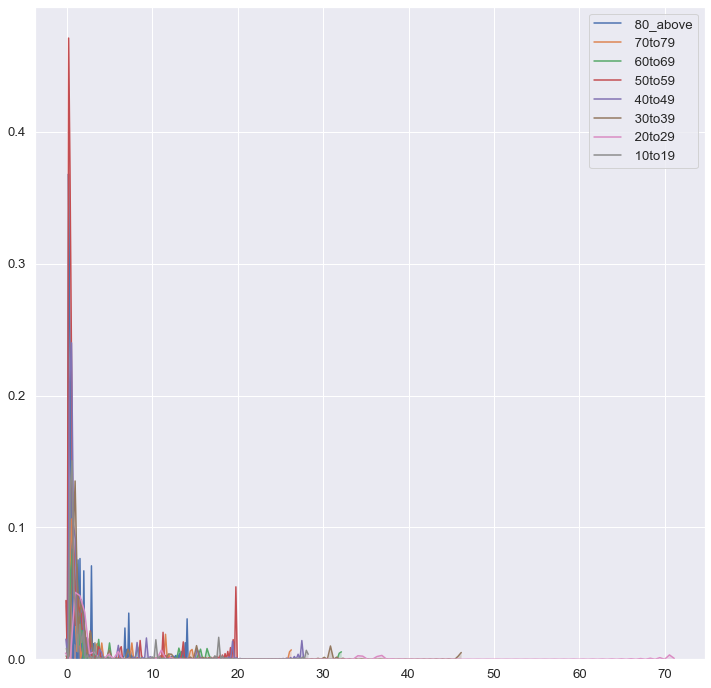

In [77]:
# Full plotting of all suicides rates values relative to age-range
sns.set(rc={'figure.figsize': [12,12]}, font_scale=1.2)
for label in suicides_rates_columns:
    sns.kdeplot(df[label],shade=True)

Note: the x-axis show the values of the labels compared to each other to the nearest two decimals. And i will show the realized notes to the values on the drawing. To compare to the real values: Divide by 100.
As it ’s seen form this plot that shows the rates of suicides of different age ranges:
1. Most of the values of the  age ranges tends to be distributed near zero as a rate & this is accepted as most of the people tends to live cause of the human nature. 
2. Many of the 50_59 age range values tends to show a noticable increase in percentage of high suicide rates(11, 16-20) value ranges.
3. 10_19 age ranges tends to show not a little percent of values in the range nearly (10,17).
4. Most of 70_79 age range values tends to be near zero and this indicates that: this is the lowest age range to commit suicide.
5. 20_29 age range values shows a peak in range of values (near zero- 5, some values in 11, some of values beyond 30"Outliers") indicating that they are the most age range to commit suicide.
6. 40_49 age range values (a little below 10 & near 30) tends to show not a little percent.

###### Going on plotting of suicide rates for each age-range

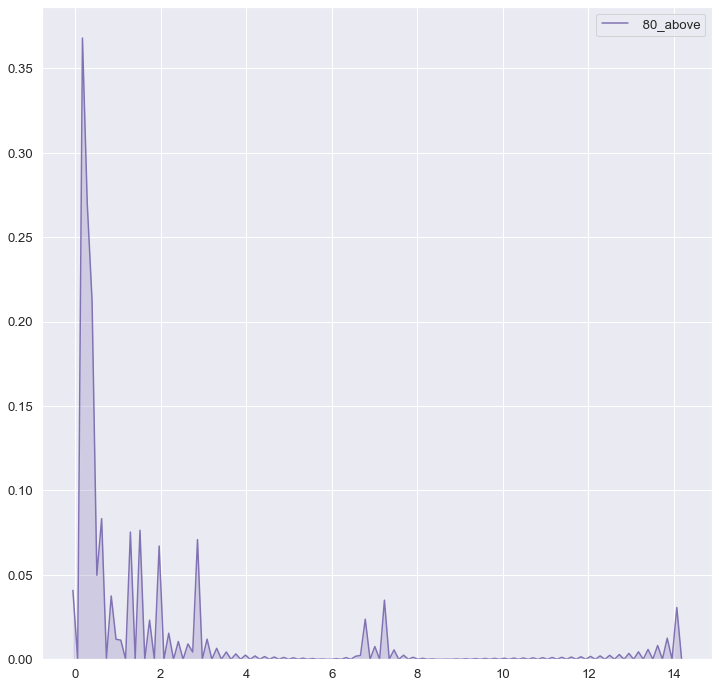

In [78]:
sns.kdeplot(df[' 80_above'],shade=True,color='m')

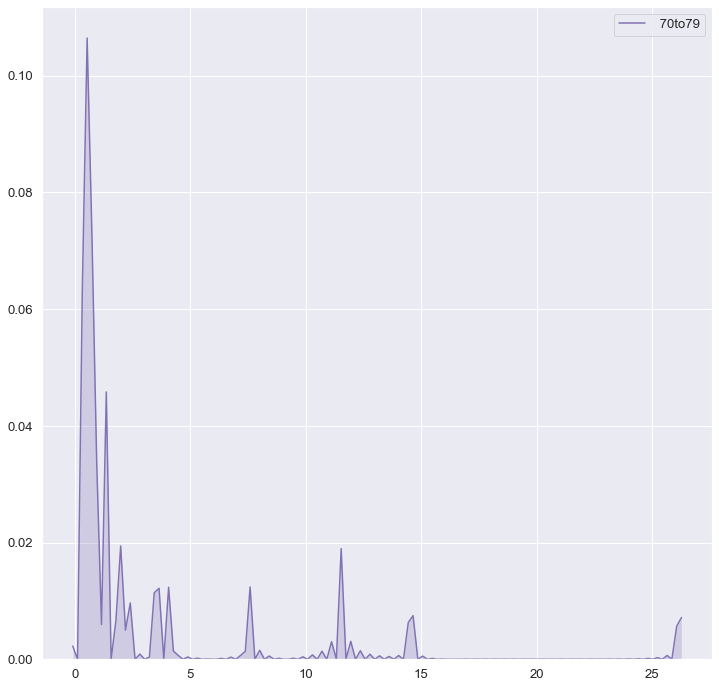

In [79]:
sns.kdeplot(df[' 70to79'],shade=True,color='m')

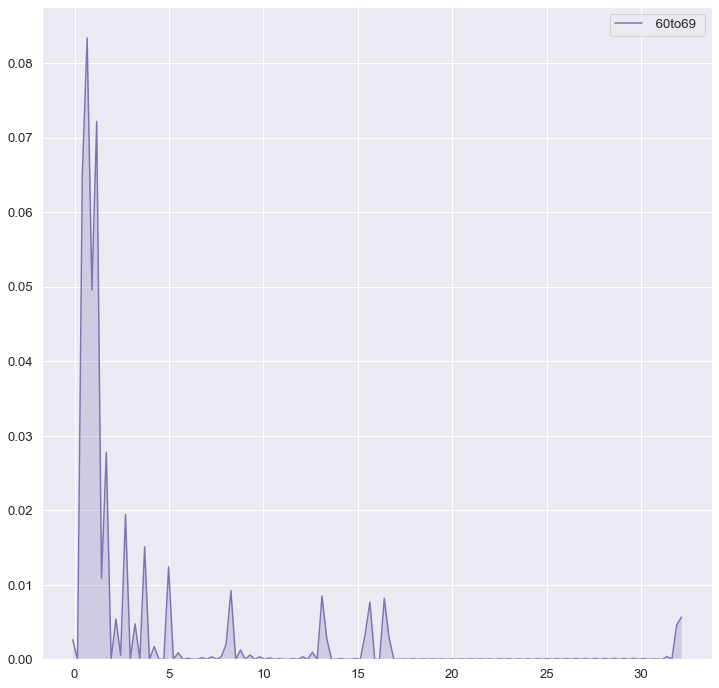

In [80]:
sns.kdeplot(df[' 60to69 '],shade=True,color='m')

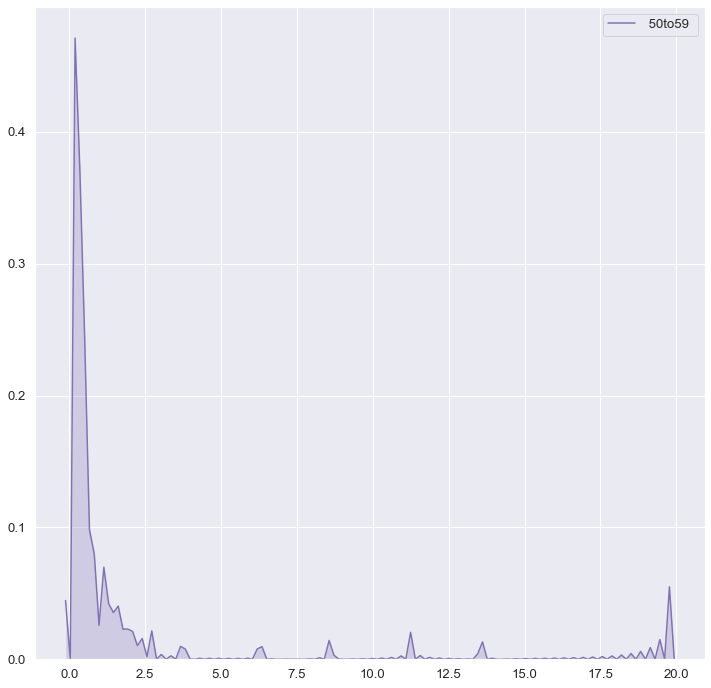

In [81]:
sns.kdeplot(df[' 50to59 '],shade=True,color='m')

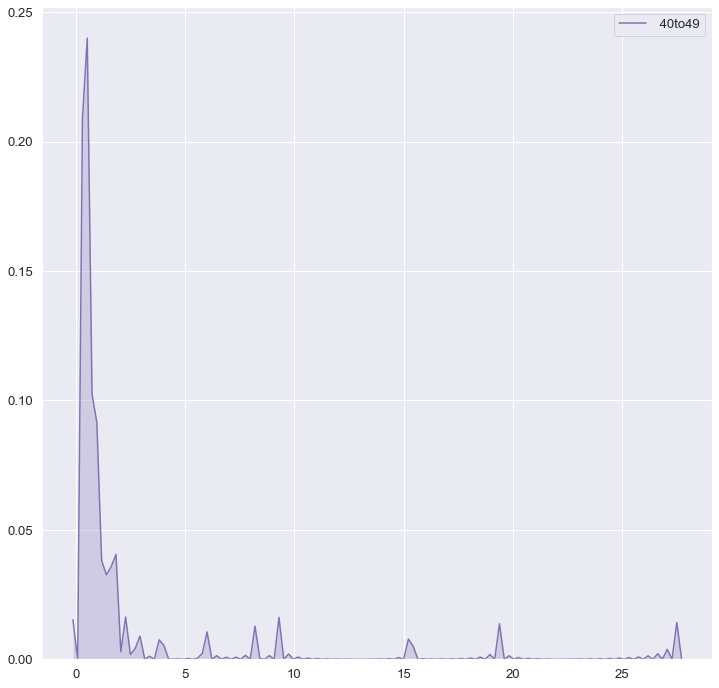

In [82]:
sns.kdeplot(df[' 40to49'],shade=True,color='m')

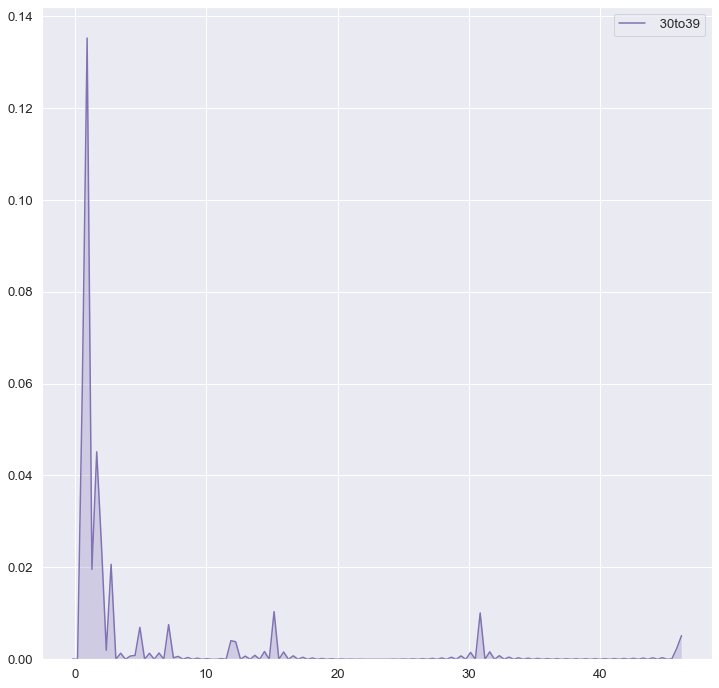

In [83]:
sns.kdeplot(df[' 30to39'],shade=True,color='m')

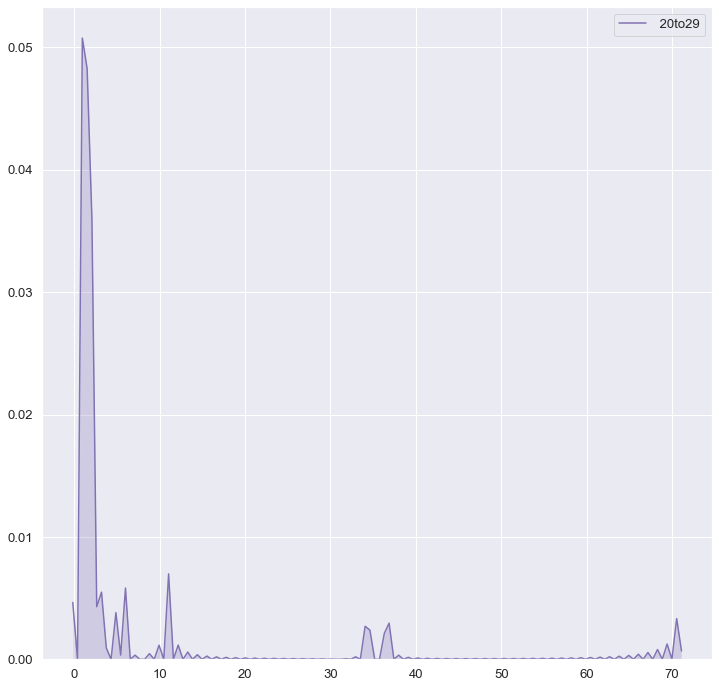

In [84]:
sns.kdeplot(df[' 20to29'],shade=True,color='m')

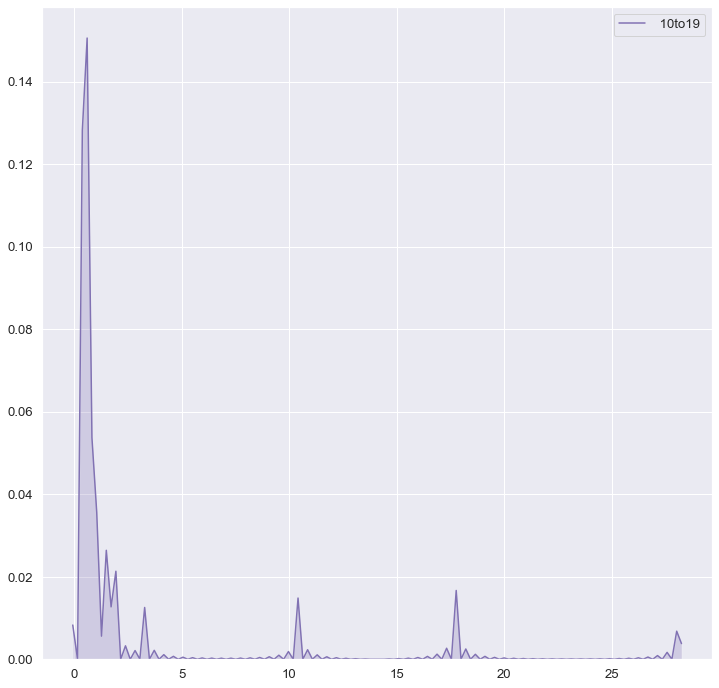

In [85]:
sns.kdeplot(df[' 10to19'],shade=True,color='m')

As it is observed above and confirming the results mentioned before: 
1. The highest suicides rates exists in age range 20_29 followed by 30_39 age range.
2. suicide rates decrease as the age range increases.
More notes:
3. the values of suicide rates may differ from suicide rates itself as many values of suicide rates can be found in age range more than another range.
4. age range 10_19 shows medium rate of suicide relative to its values.
5. age range 50_59 shows a percentage of values of suicides higher than that of 40_49.

*Since the distribution of the values of other labels are not important away of the suicide rates, so we will go directly for Bivarite distribution plots.*

#### A) Bivariate plots

In [86]:
df.head()

,Country,Sex,80_above,70to79,60to69,50to59,40to49,30to39,20to29,10to19,Mental _hospitals,health_units,outpatient _facilities,day _treatment,residential_facilities,Psychiatrists,Nurses,Social_workers,Psychologists,Happiness Score,Lower Confidence Interval,Upper Confidence Interval,Economy (GDP per Capita),Family,Health (Life Expectancy),Freedom,Trust (Government Corruption),Generosity,Dystopia Residual,population
0,Afghanistan,Both sexes,0.039060,0.043560,0.051425,0.089320,0.167112,0.364228,0.613326,0.279713,0.003,0.012,0.006,1.070439,0.673053,0.231,0.098,2.612167,0.296,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558,24546
1,Afghanistan,Female,0.010452,0.004853,0.006762,0.012480,0.027991,0.050976,0.100800,0.052776,0.003,0.012,0.006,1.070439,0.673053,0.231,0.098,2.612167,0.296,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558,11909
2,Afghanistan,Male,0.028864,0.038456,0.044296,0.075795,0.138180,0.312570,0.510679,0.222000,0.003,0.012,0.006,1.070439,0.673053,0.231,0.098,2.612167,0.296,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558,12636
3,Albania,Both sexes,0.011736,0.015023,0.016860,0.031278,0.032214,0.020740,0.032175,0.021250,0.068,0.068,0.410,1.070439,0.445000,1.471,6.876,1.060000,1.231,4.655,4.546,4.764,0.95530,0.50163,0.73007,0.31866,0.05301,0.16840,1.92816,2549
4,Albania,Female,0.004251,0.004557,0.005577,0.008976,0.009300,0.005440,0.015246,0.014210,0.068,0.068,0.410,1.070439,0.445000,1.471,6.876,1.060000,1.231,4.655,4.546,4.764,0.95530,0.50163,0.73007,0.31866,0.05301,0.16840,1.92816,1259


In [87]:
suicides_rates_columns

[' 80_above',
 ' 70to79',
 ' 60to69 ',
 ' 50to59 ',
 ' 40to49',
 ' 30to39',
 ' 20to29',
 ' 10to19']

After trying many kinds of plots, it was found that the best one for our data in the jointplot is the scatter plot. So, Going in a loop that gives a visual statistics for the relations between the suicide rates in each age range & the rest of the labels.

C:\Users\merab\Anaconda3\lib\site-packages\seaborn\axisgrid.py:1675: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f = plt.figure(figsize=(height, height))


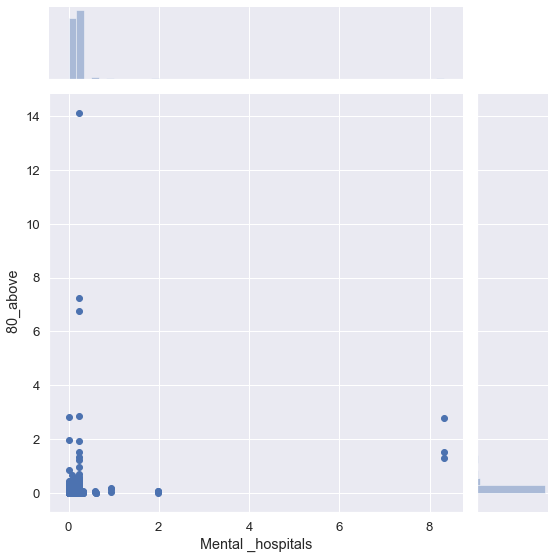

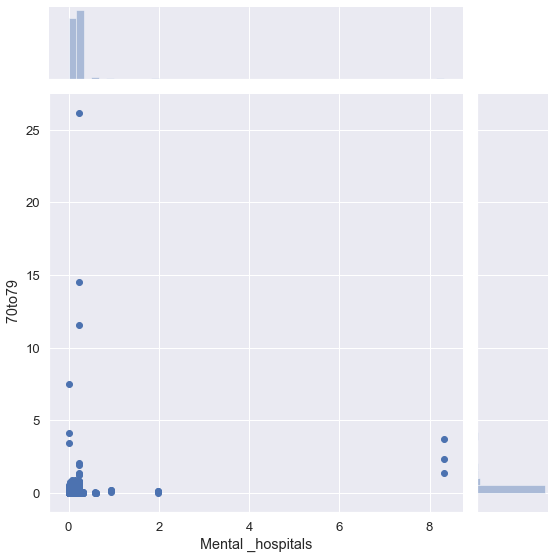

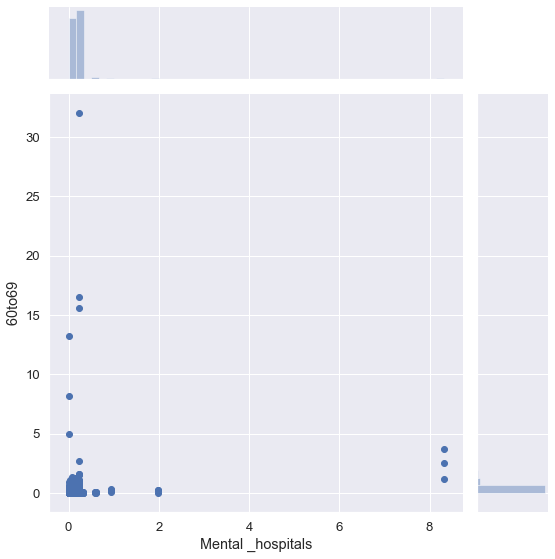

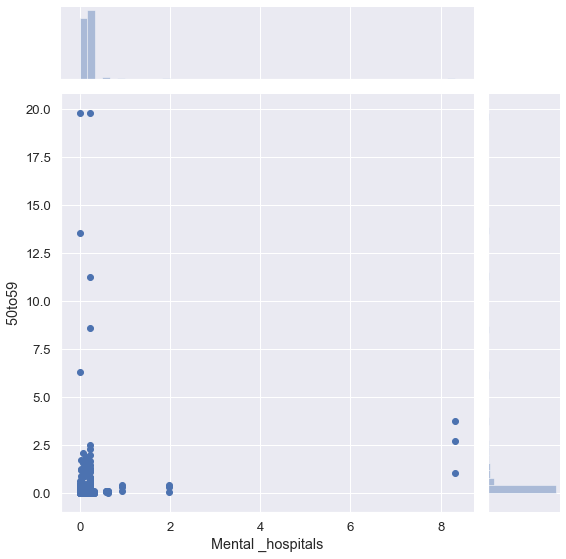

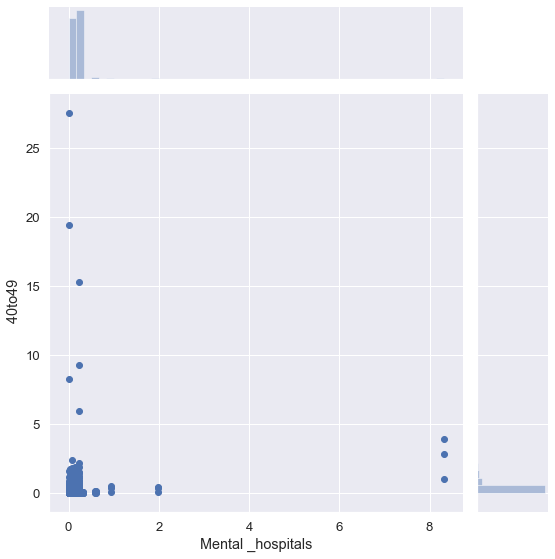

...

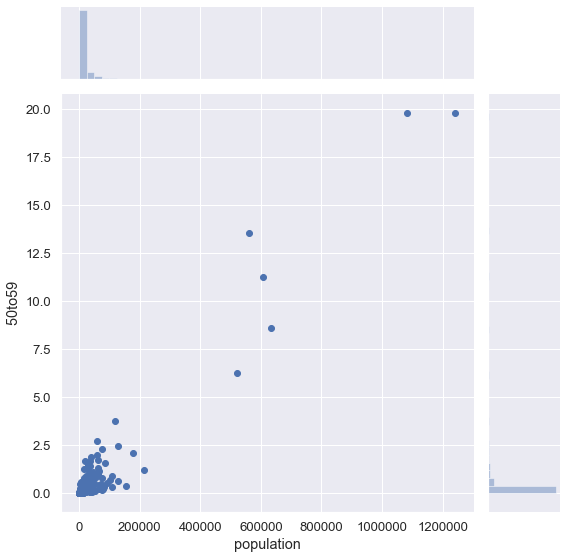

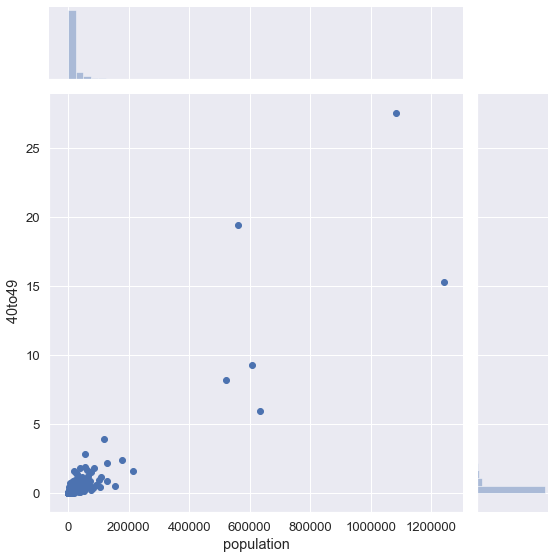

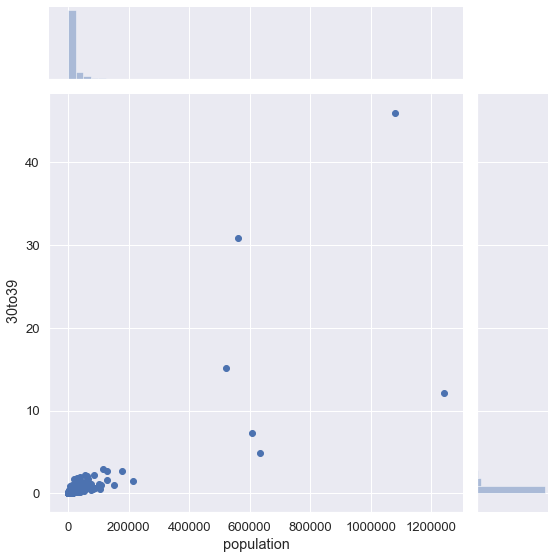

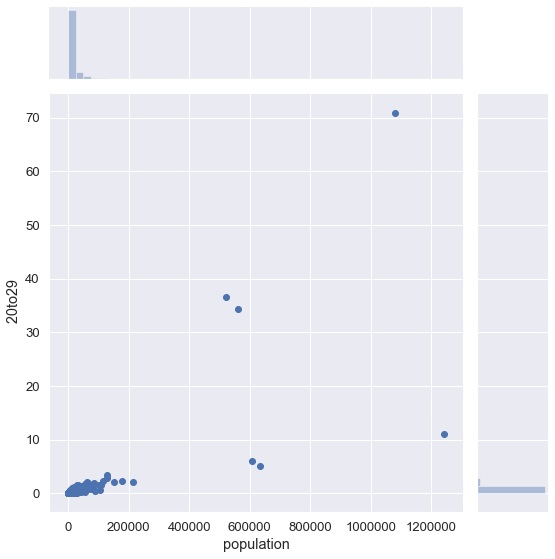

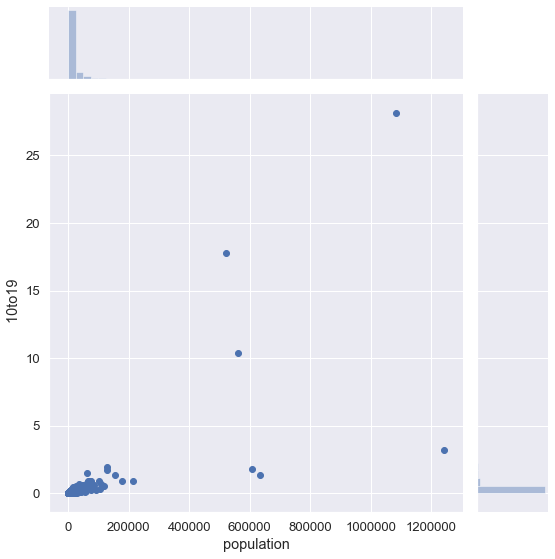

In [88]:
#Assigning fig size
sns.set(rc={'figure.figsize': [12,12]}, font_scale=1.2)
#Giving some cool coloring
cmap = sns.cubehelix_palette(as_cmap=True, dark=0, light=1, reverse=True)
#Drawing jointplot with kind scatter
for i in list(df.columns[10:]):
    for j in suicides_rates_columns:
        sns.jointplot(i,j,data=df,cmap=cmap, height=8)

From the jointplots existing above we can conclude the following:
0. There is a high rates of suicides on the existance of low number of mental hospitals.
1. As the mental hospitals increase, the rate of suicides in each age range decreases.
2. It is realised that there is outliers that shows an increase of suicide rates on the huge increase of mental hospitals and this may indicate that those mental hospitals was done by the government to face the dpression and suicidal acts. This depression & suicidal acts may mean that there life circumstances are too bad but why do the governments that doesn’t care about its citizens care about providing mental hospitals. This may be explained on going further on our analysis process.
3. Since health units & outpatient facilities role is to care about less mental illness cases so by looking at their statistical visualizations, it was found that on their hige increase, the rate of suicide goes to its minimum range (nearly zero). Since the existance of health units & out patient facilities means a more care about citizen’s mental health, then this indicates that:                                                                                                                
A) as the careness about mental health of citizens increase, the rates of suicide nearly vanishes.                             
B) since these facilities gives an early care about mental issues, then this means that the early care about the mental issues helps effectively in reducing suicidal acts.                                                                                   
4. Health units & outpatient facilities visualized statistics show that, there is some of suicide rates that appear on the existance of a not little number of those facilities & this may indicate as the menatl hospital statistics indicated that those are made by government to face the suicidal acts and mental issues.
5. We can get from the point of not a little number of facilities and the existance of suicide rates that those facilities were made to face the problem of suicidal acts in its beginning or indicates that the country not caring about mental health of its patients.                                                                                                                      
5.1 As most of mental health hospitals and health units are governmental & as existing of not a little number of them show -nearly- absence of suicide rates this may indicates that the existing of a rate of suicides on the existing of not alittle outpatient facilities might be caused by the little existance of governmental facilities in these countries that the citizens tend to commit suicides despite the existance of outpatient facilities.
6. Health units seems to be more effective than outpatient facilities. This can be due to the high expenses of outpatient facilities.
7. As the daily treatment increase, the suicide rates decreases & nearly vanishes.
8. There exists some suicide rates despite the existance of a few daily treatment and this phenomenon repeated at all of the age ranges with the -nearly- the same rate. 
9. All of the statistical visualizations that draws the relation between Psychiatrists & suicides rates at all ages gives -nearly- the same behavior which shows the existance of a few -but not a little- suicides rates depite the existance of -not high but- a sufficient number of psychiatrists.
10. Also as number 9, all of visualizations of different age ranges show the same behavior, which is there is a surprising increase in the suicide rates after its dissapperance on the high increase of rates of numbers of nurses.
11. As the number of social workers & psychologists increase the rate of suicide rates decrease. Despite that, on the huge increase of psychologists, a surprising -but not high- rates of suicides appear.
12. From the points that showed the relation between workers and facilities of mental health & suicide rates, its noticed that; as the rates of this facilities and workers increases in a huge number, the suicides rates begin to appear again. This might imply that the countries that contribute with that number of workers in the mental field and facilities are trying to develop its citizens mental health or that a wrong methodologies are followed in dealing with mental issues. Making sure of this imply may happen on further analysis on the following years.
13. On going for the visualizations that draw the relation between suicides rates & happiness index. a strange behavior was shown; The countries with near medium and medium happiness score showed high suicide rates in all of age ranges.               
13.1 20_29 age range suicide rates showed a little rates of suicide in the countries of medium happiness score. 
13.2 The old age_ranges from(50_59 to older) showed a suicide rates which is not little despite the high happiness score that their countries shows.                                                                                                         
14. On the middle level economy and high level economy countries, the suicides rates show an increase more than that of low economy.                                                                                                                       
14.1 This phenomenon dissappears at the high economy at the age range of 20_29.                                                
14.2 The suicides rates of kids (10_19 age range) shows an increase on the middle economy countries.                           
15. Neglecting the outliers, on the increase of the  of number of (family, health(Life expectancy)), the number of suicides tends to show a little but not huge increase.
16. Neglecting the outliers, on the low & high freedom rate, the rates of suicides tend to increase.
17. On increasing the trust(Government corruption), the suicide rates decrease.
18. Neglecting the ouliers, from the statistical visualization between population & suicides rates of different age ranges, there is a positive correlation between them.   

In [89]:
df.head()

,Country,Sex,80_above,70to79,60to69,50to59,40to49,30to39,20to29,10to19,Mental _hospitals,health_units,outpatient _facilities,day _treatment,residential_facilities,Psychiatrists,Nurses,Social_workers,Psychologists,Happiness Score,Lower Confidence Interval,Upper Confidence Interval,Economy (GDP per Capita),Family,Health (Life Expectancy),Freedom,Trust (Government Corruption),Generosity,Dystopia Residual,population
0,Afghanistan,Both sexes,0.039060,0.043560,0.051425,0.089320,0.167112,0.364228,0.613326,0.279713,0.003,0.012,0.006,1.070439,0.673053,0.231,0.098,2.612167,0.296,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558,24546
1,Afghanistan,Female,0.010452,0.004853,0.006762,0.012480,0.027991,0.050976,0.100800,0.052776,0.003,0.012,0.006,1.070439,0.673053,0.231,0.098,2.612167,0.296,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558,11909
2,Afghanistan,Male,0.028864,0.038456,0.044296,0.075795,0.138180,0.312570,0.510679,0.222000,0.003,0.012,0.006,1.070439,0.673053,0.231,0.098,2.612167,0.296,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558,12636
3,Albania,Both sexes,0.011736,0.015023,0.016860,0.031278,0.032214,0.020740,0.032175,0.021250,0.068,0.068,0.410,1.070439,0.445000,1.471,6.876,1.060000,1.231,4.655,4.546,4.764,0.95530,0.50163,0.73007,0.31866,0.05301,0.16840,1.92816,2549
4,Albania,Female,0.004251,0.004557,0.005577,0.008976,0.009300,0.005440,0.015246,0.014210,0.068,0.068,0.410,1.070439,0.445000,1.471,6.876,1.060000,1.231,4.655,4.546,4.764,0.95530,0.50163,0.73007,0.31866,0.05301,0.16840,1.92816,1259


We will go with pair plotting that deals with the same labels as the above joint plots but with giving gender as hue. Since we have dealt before with the labels that will be visualized so we will only write down the important notes about the effect of gender (If any).

C:\Users\merab\Anaconda3\lib\site-packages\seaborn\axisgrid.py:1270: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  squeeze=False)


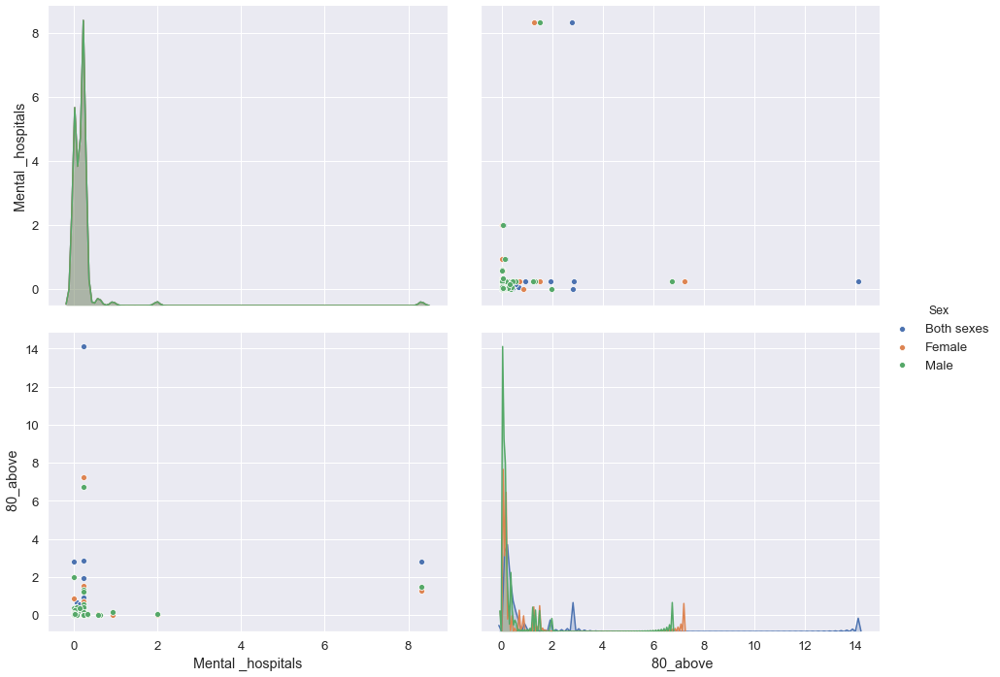

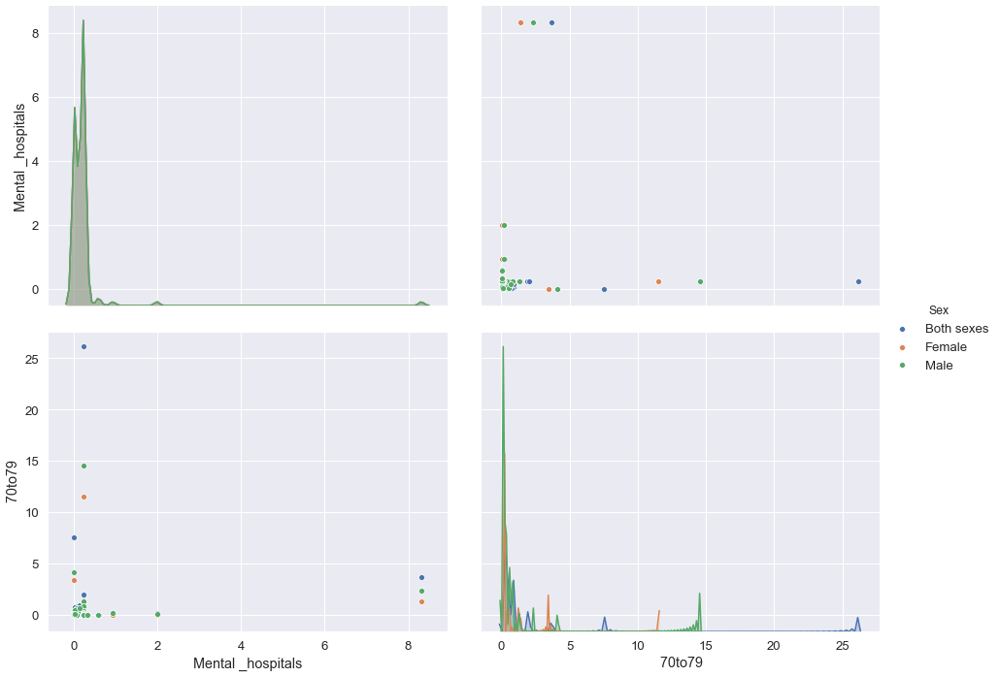

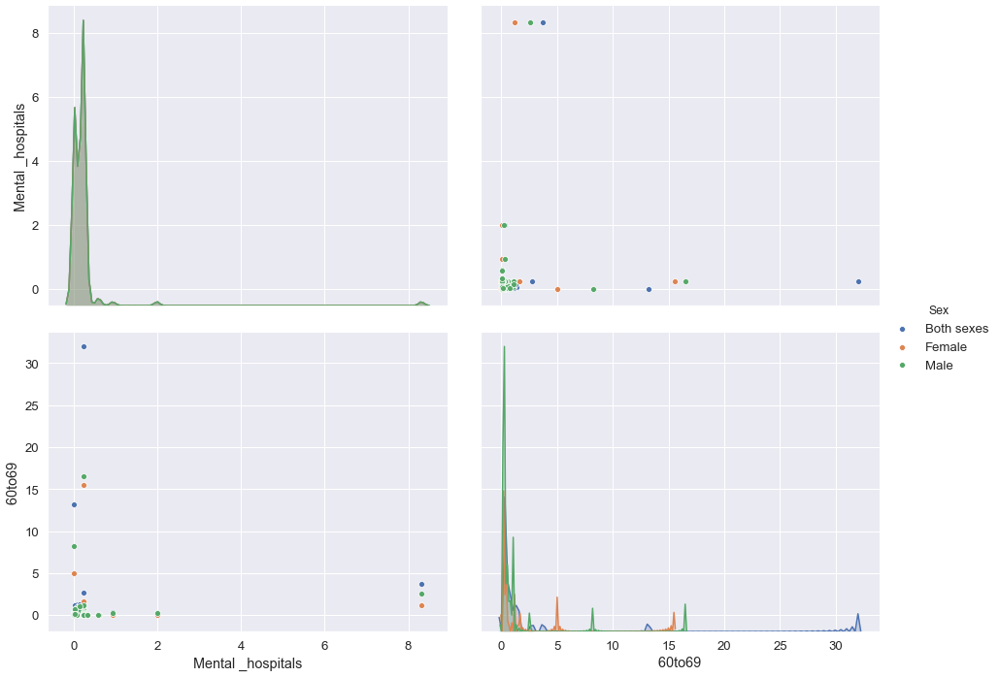

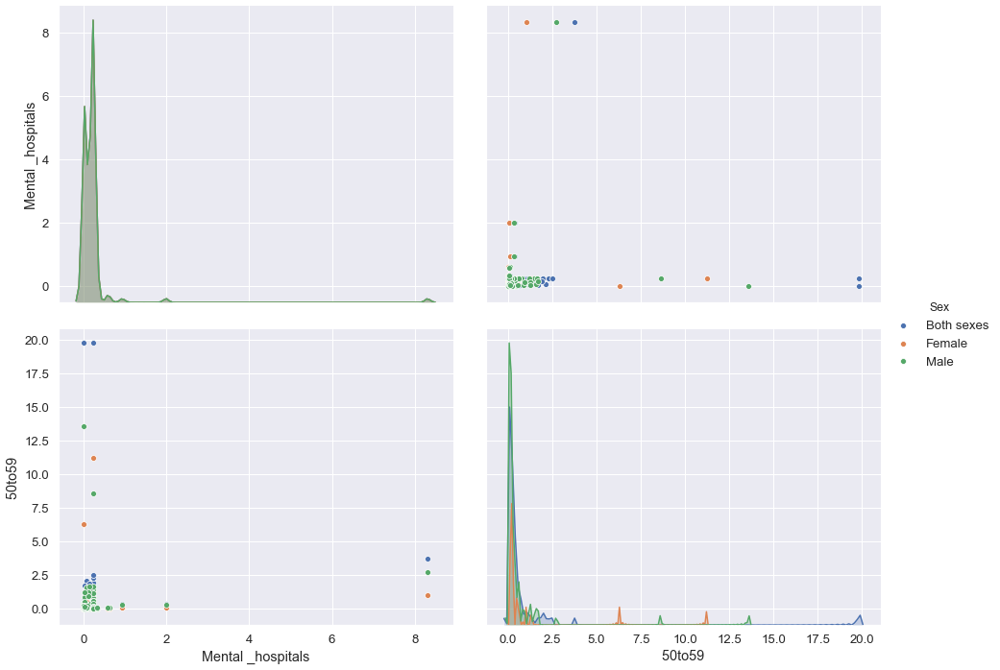

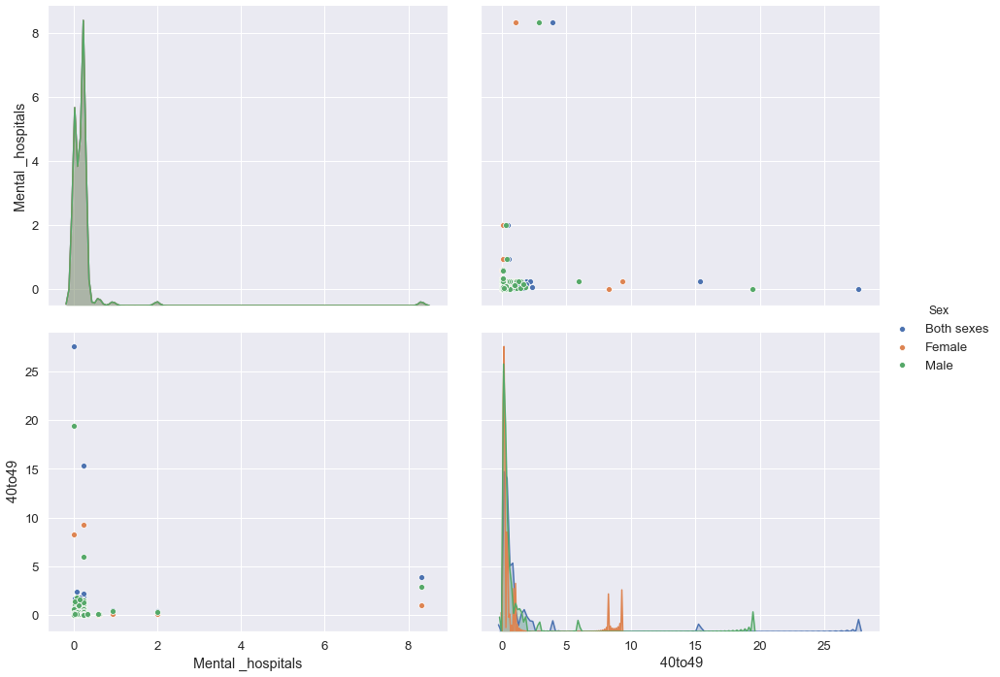

...

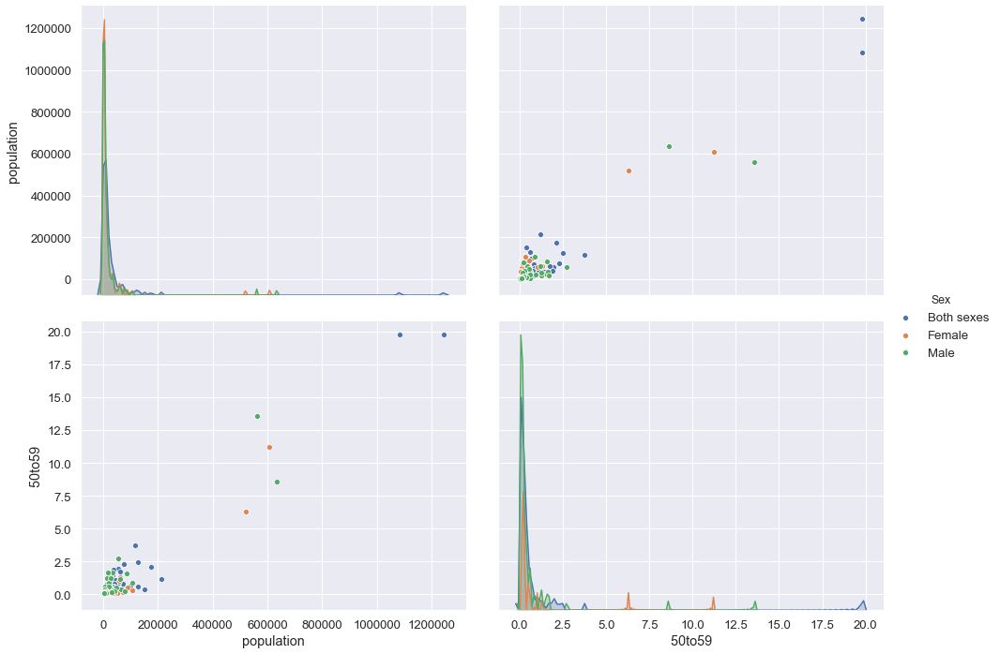

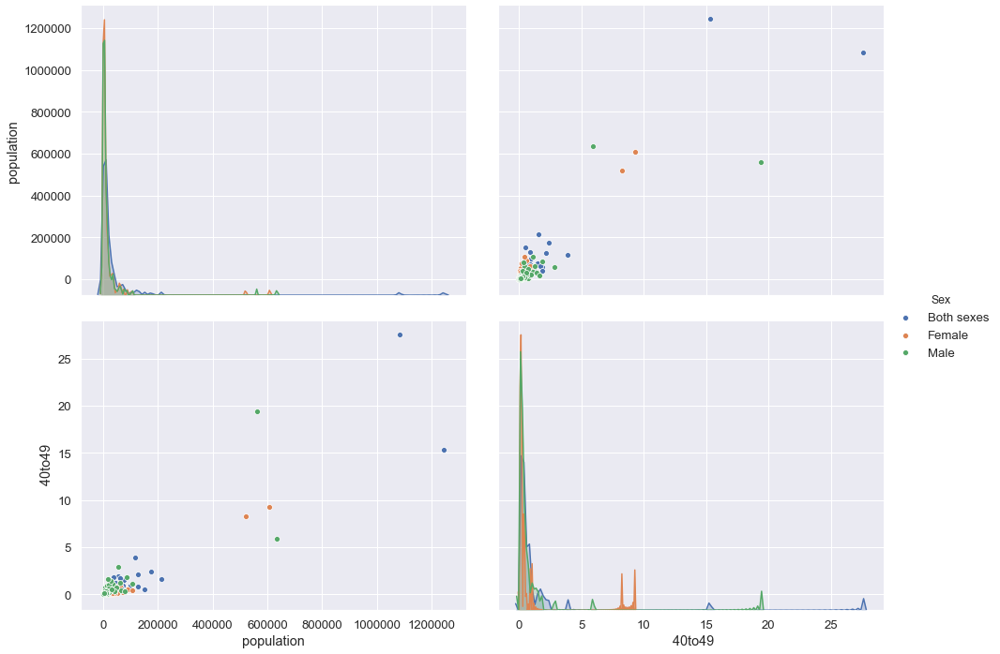

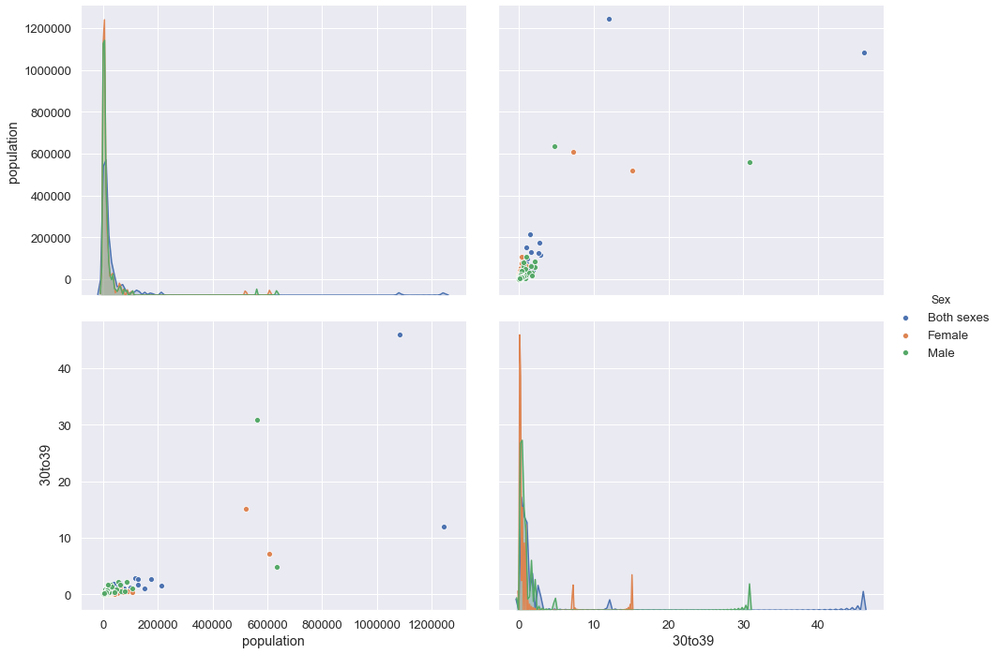

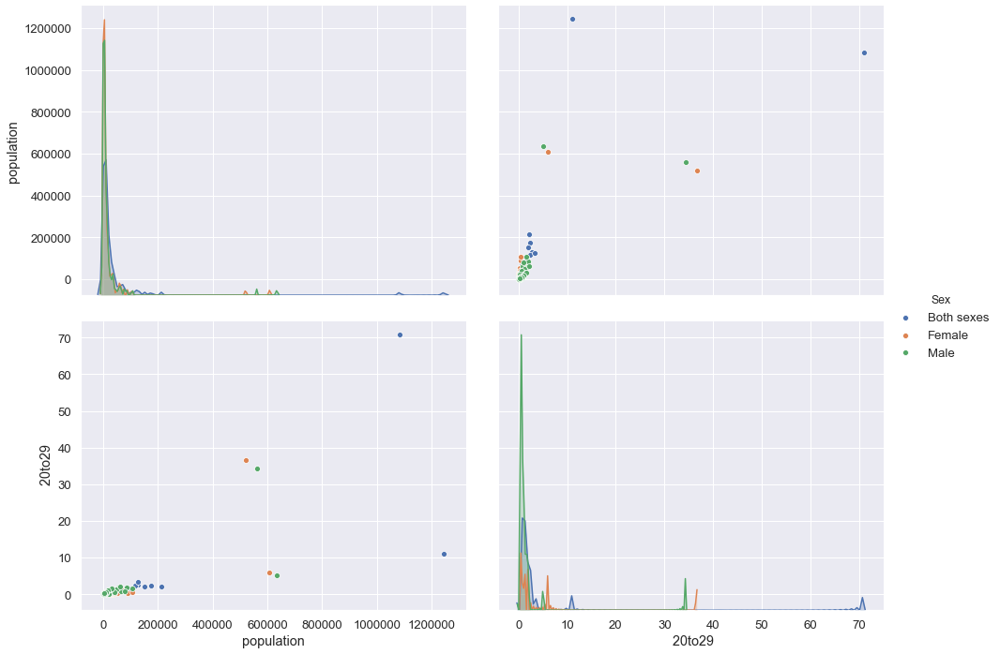

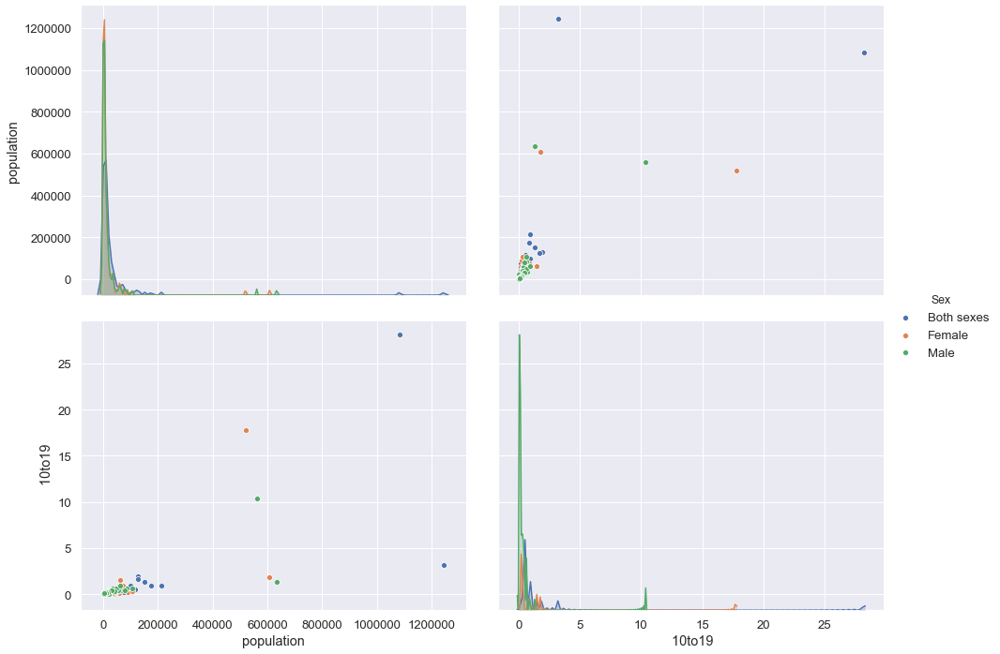

In [90]:
for i in list(df.columns[10:]):
    for j in suicides_rates_columns:
        sns.pairplot(df,vars=[i,j],hue='Sex',height=5, aspect=1.3)

1. In general, women tends to show little suicide rates than men.
2. On high -but not so do crowded- population, women tends to show high suicide rate near men rates & the women rates exceeds men rates in the age range 10_19.
3. The outliers of suicides rates in range 10_19 tends to be in females. This may indicate abuses towards this age range of females.
5. Until age range (50_59) women with little freedom tends to commit suicides more than men specially in age ranges (10_19 & 20_29).
There is so many other observations but it ’s not inportant as it’s known by default. As an example, men tends to show more suicide rates on low gdp per capita but that may be reasoned easily as the men are -mostly- responsible about funding their families.

###### Second, we would go with some of **Categorical** plots to show the relation between categorical values and the suicides rates.

Since most of our data is numerical(Only two categorical data labels "Country", "Sex" ), we will not go for a heavy focus on categorical plots.

#### A) Categorical estimation plots

In [91]:
sns.set(rc={'figure.figsize': [20,20]}, font_scale=1.2)

*Going on Barplot showing the relation between Countries & the suicide rate of each age range.*

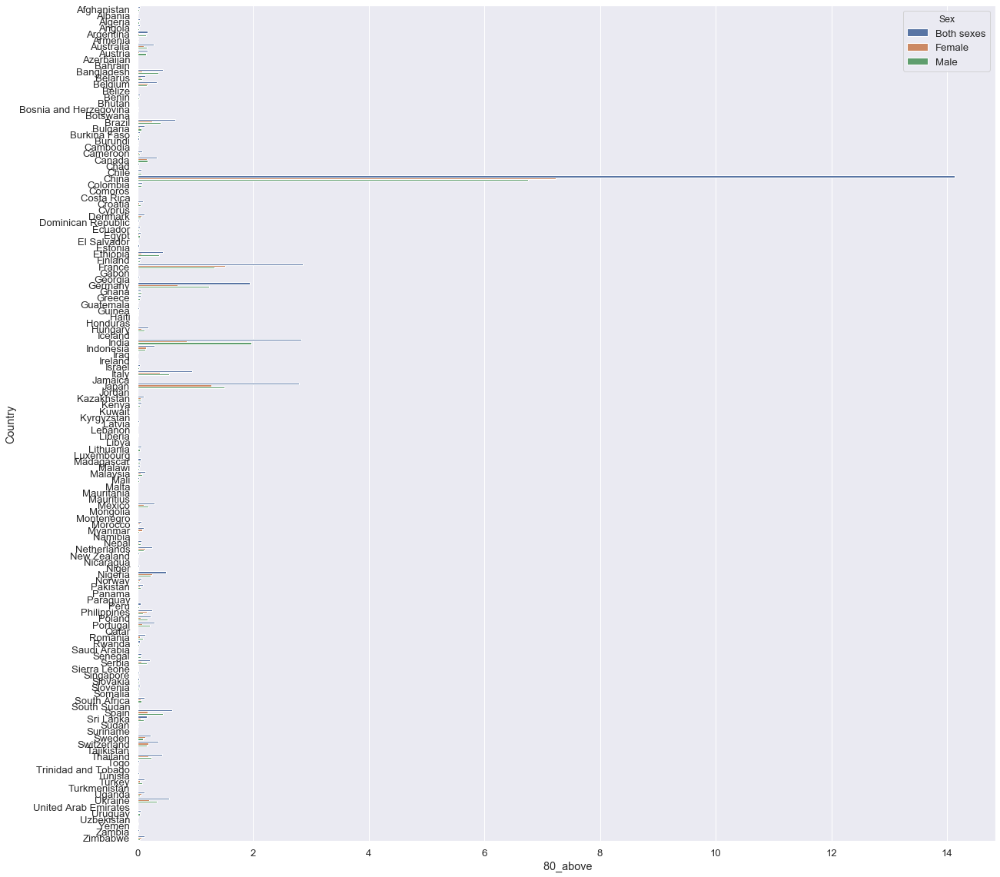

In [92]:
sns.barplot(y='Country',x=' 80_above',hue='Sex',data=df)

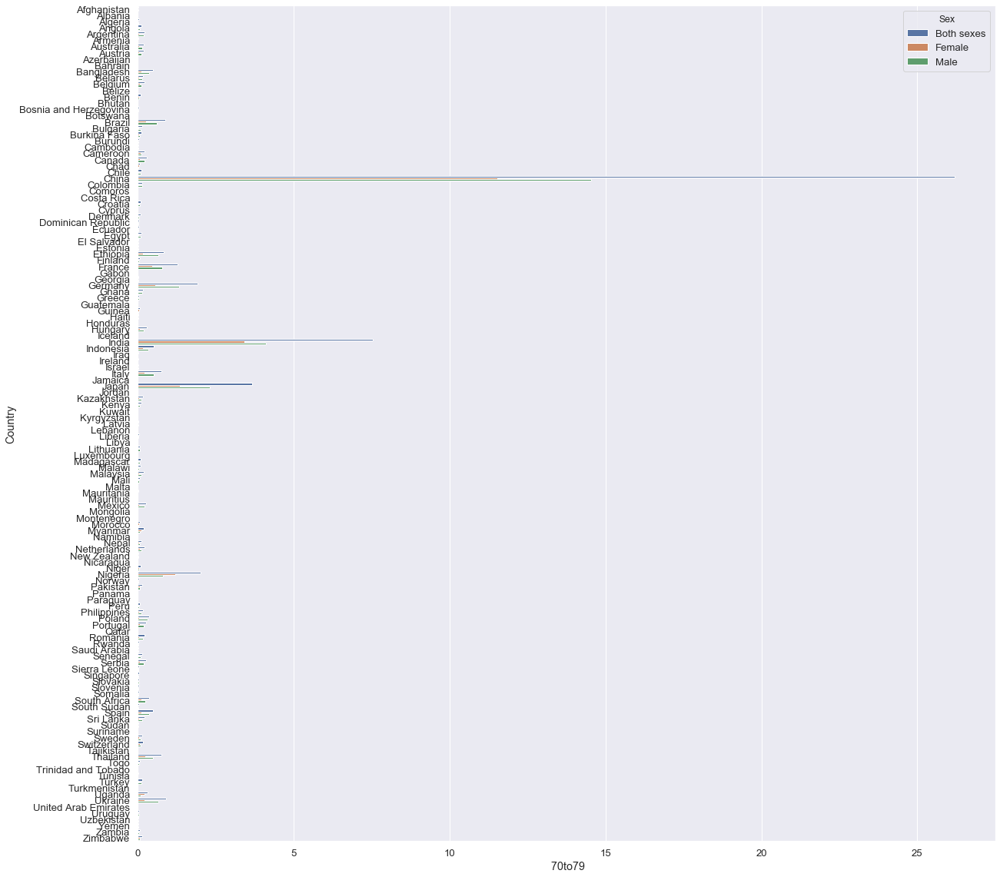

In [93]:
sns.barplot(y='Country',x=' 70to79',hue='Sex',data=df)

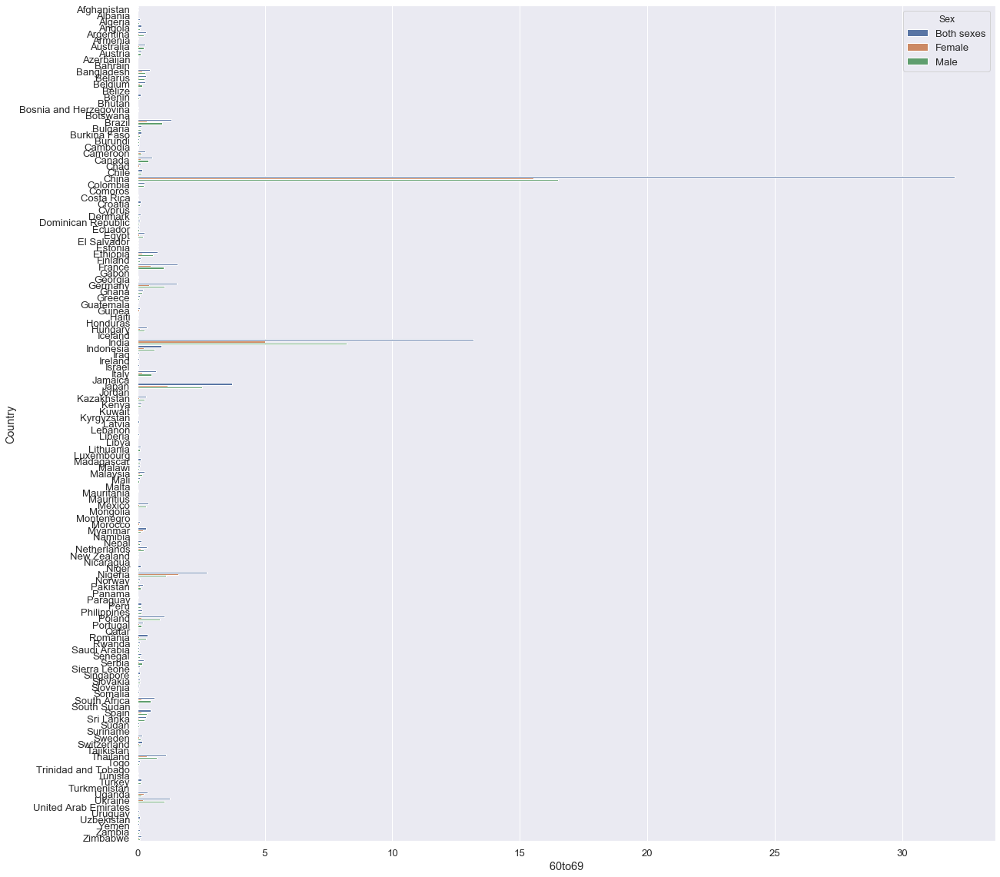

In [94]:
sns.barplot(y='Country',x=' 60to69 ',hue='Sex',data=df)

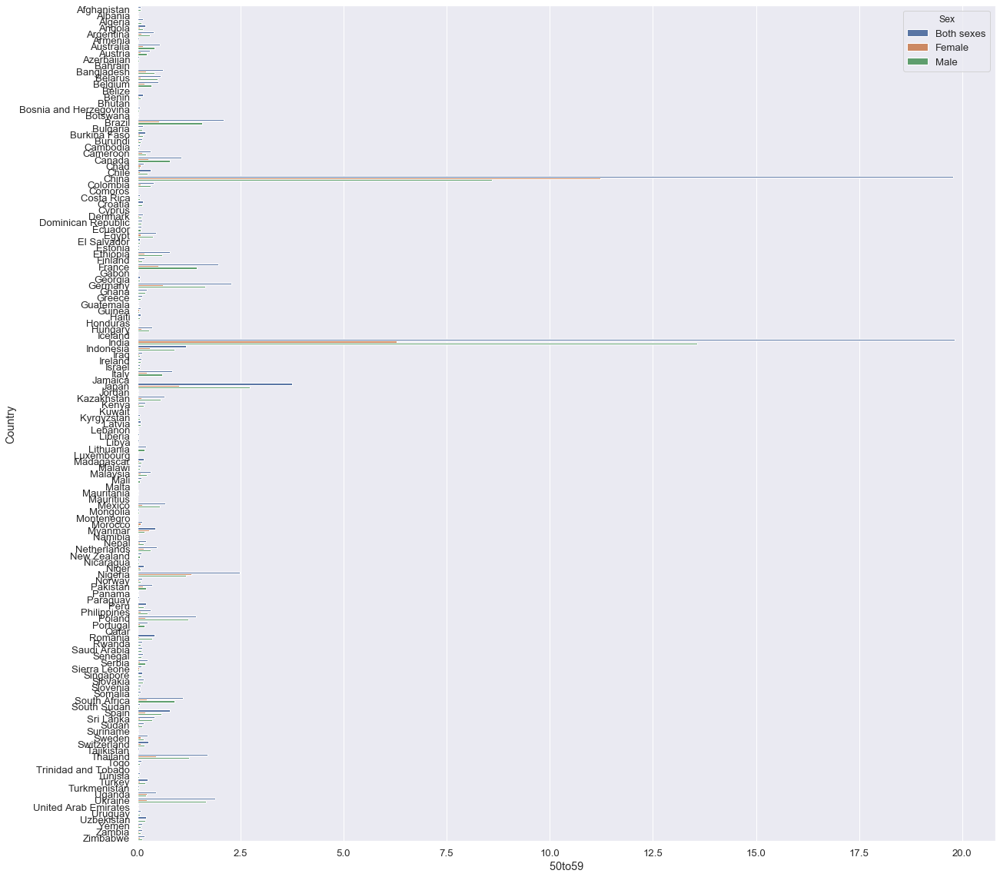

In [95]:
sns.barplot(y='Country',x=' 50to59 ',hue='Sex',data=df)

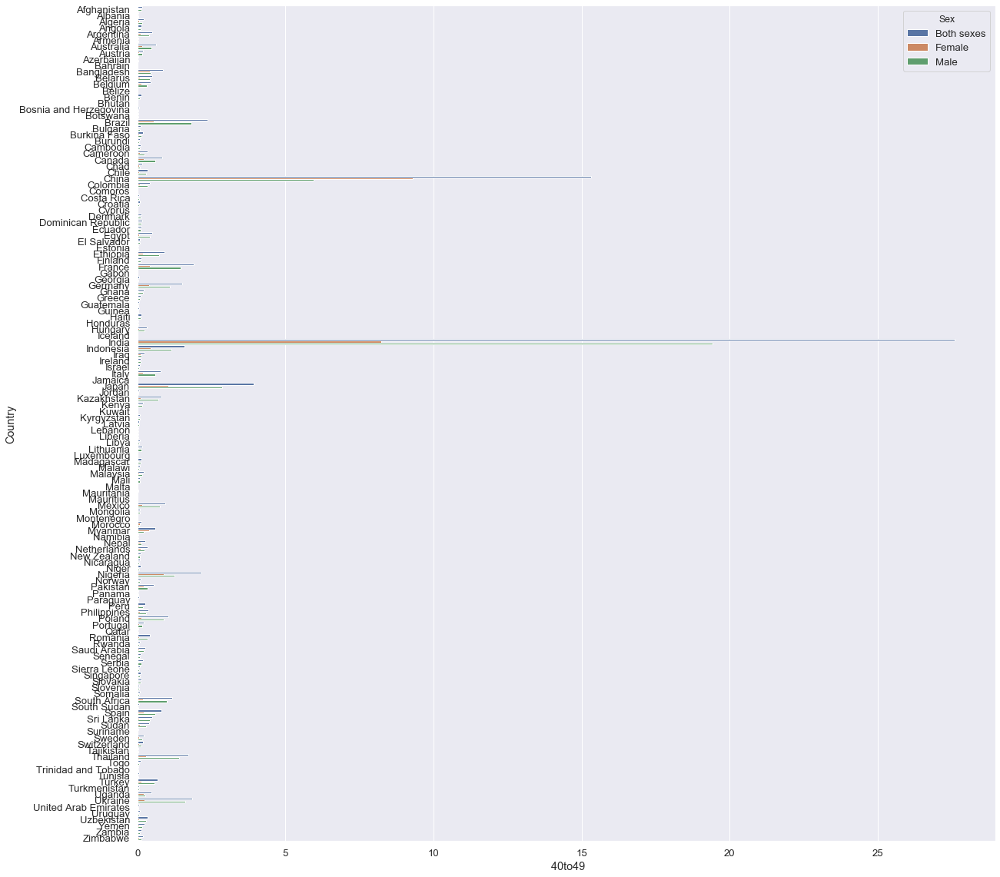

In [96]:
sns.barplot(y='Country',x=' 40to49',hue='Sex',data=df)

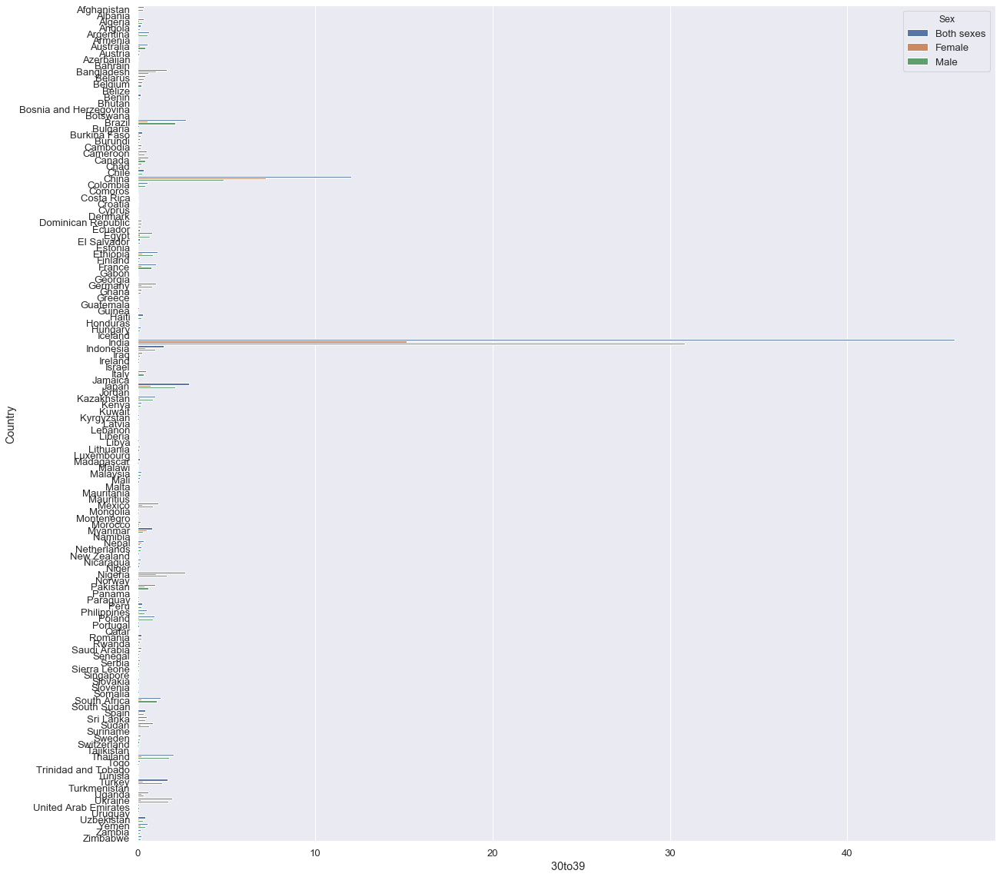

In [97]:
sns.barplot(y='Country',x=' 30to39',hue='Sex',data=df)

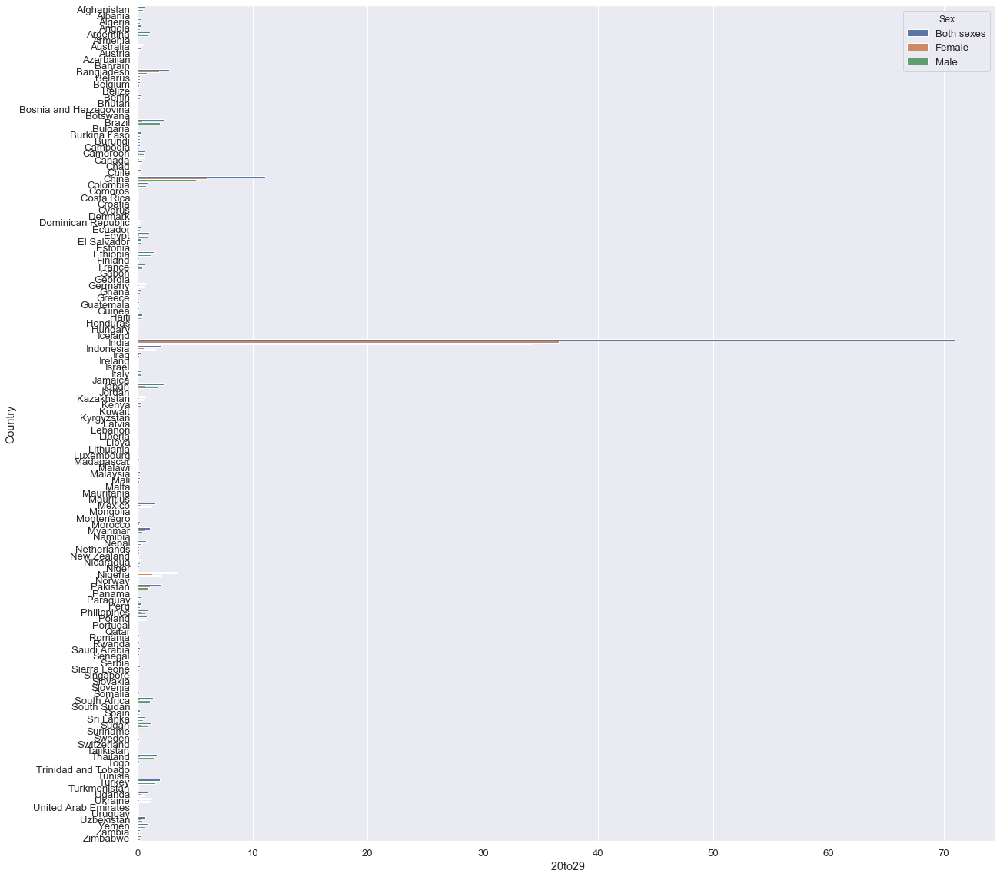

In [98]:
sns.barplot(y='Country',x=' 20to29',hue='Sex',data=df)

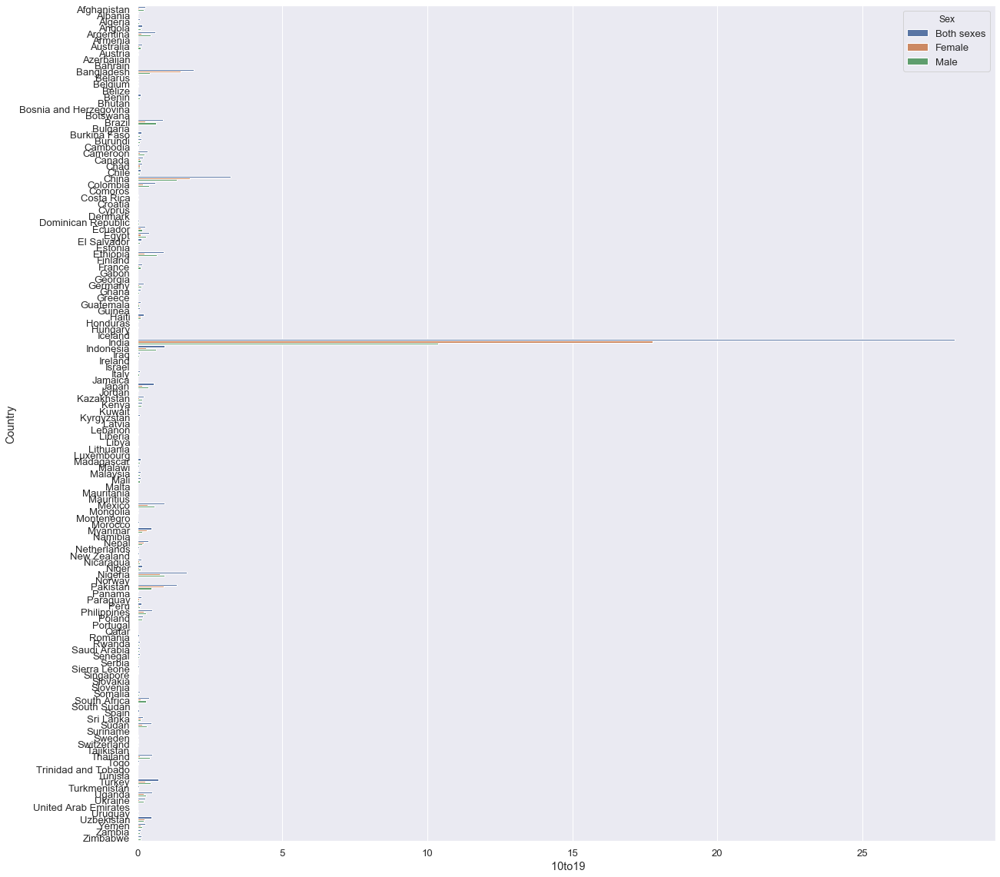

In [99]:
sns.barplot(y='Country',x=' 10to19',hue='Sex',data=df)

From the plots above, we can realise that:
1. In age_range 80_above, the highest suicide rate exists in China for the favor of females, followed by france India& Japan by a huge difference for the favor of males, followed by Italy then the rest of the countries goes -nearly- on the same range.
2. In age range 70_79, the same behavior as 80_above age range is shown.                                                       
3. In the age range 60_69, Nigeria begin to show a slightly high rate of suicides in the favor of females. But except than that it shows the same behavior as the previous 2 points.
4.  In the age range 50_59 Nigeria begin to show a slightly high rate of suicides in the favor of males& india show higher suicide rates than Japan. But except than that it shows the same behavior as the previous points.
5. In the age range 40_49 as the previous point India shows high suicides rates than China in the favor of females.
6. It is noticed that the females suicide rate of China is always than that of India.
7. On the rest of the age ranges, India shows high suicide rates as the previous.                                              
7.1 China suicide rates begins to get lower & lower on going to the lower age ranges.                                           
7.2 On the age ranges 20_29 & 10_19 India tends to show suicidal rates in the favour of females.                               
7.3 The highest rate of female suicides is in the age range 10_19. 

*Going on countplot for 'Country' & 'sex' labels*

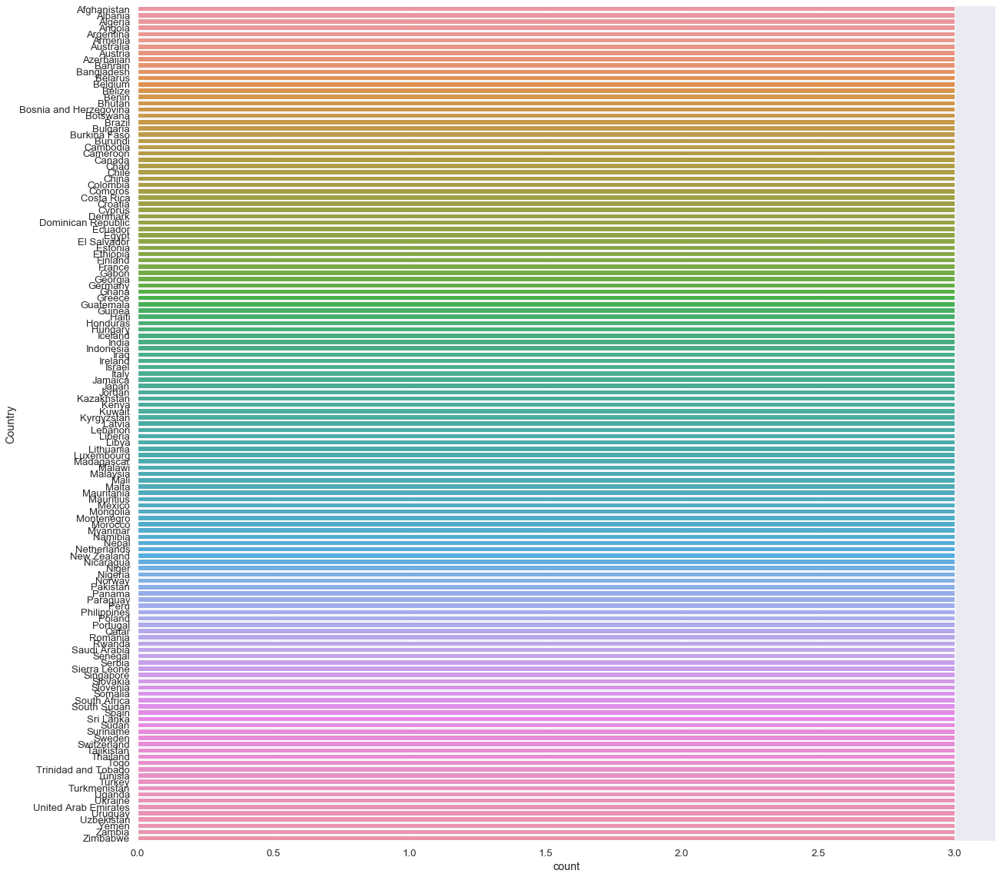

In [100]:
sns.countplot(y=df['Country'])

It shows that as we know berfore all of the countries have the same count which is 3 & we mentioned before the cause(Genderizing).

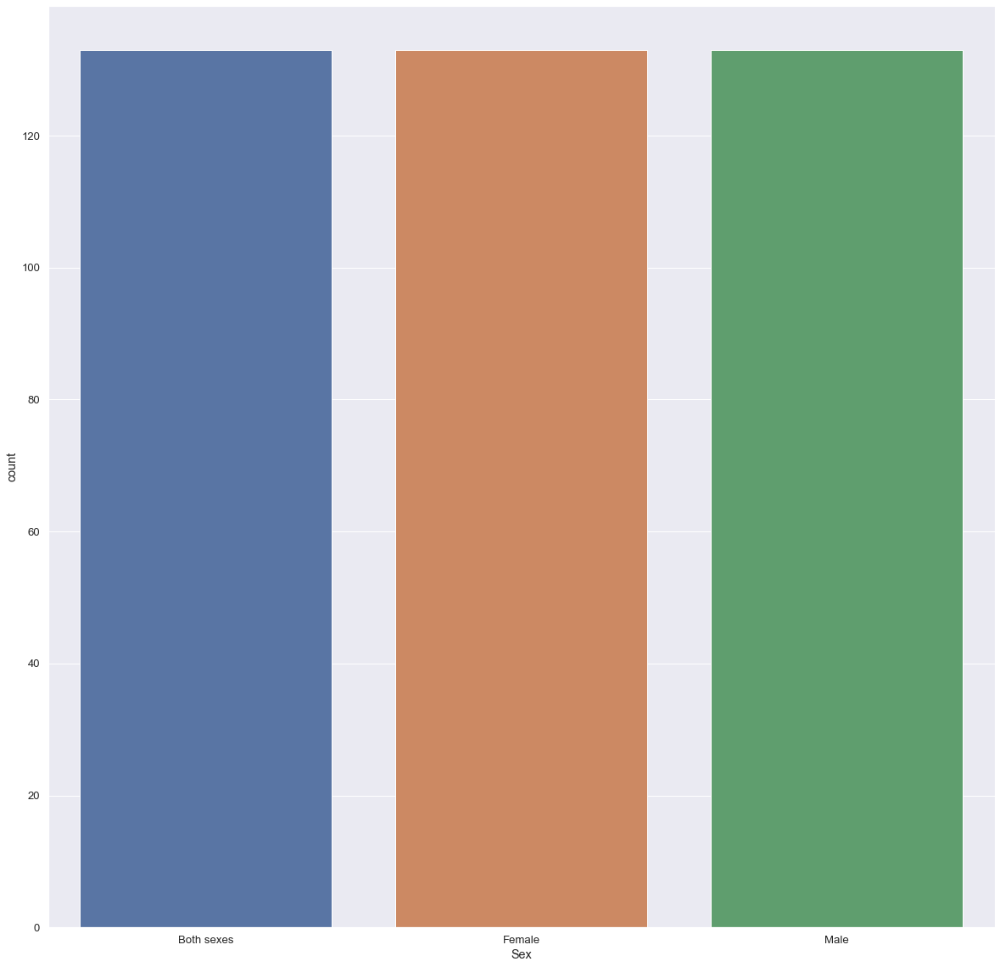

In [101]:
sns.countplot(df['Sex'])

It shows the same number also which is 133 as we remeber.

#### Third Going on Matrix plots

To show the correlation between the suicide rates of different age ranges and the rest of the labels, I am going to partionate the dataframe into parts to be clear.

In [104]:
df1=df.iloc[:,0:14]

In [105]:
df2=pd.concat([df.iloc[:,2:10],df.iloc[:,14:21]],axis=1)

In [106]:
df3=pd.concat([df.iloc[:,2:10],df.iloc[:,21:]],axis=1)

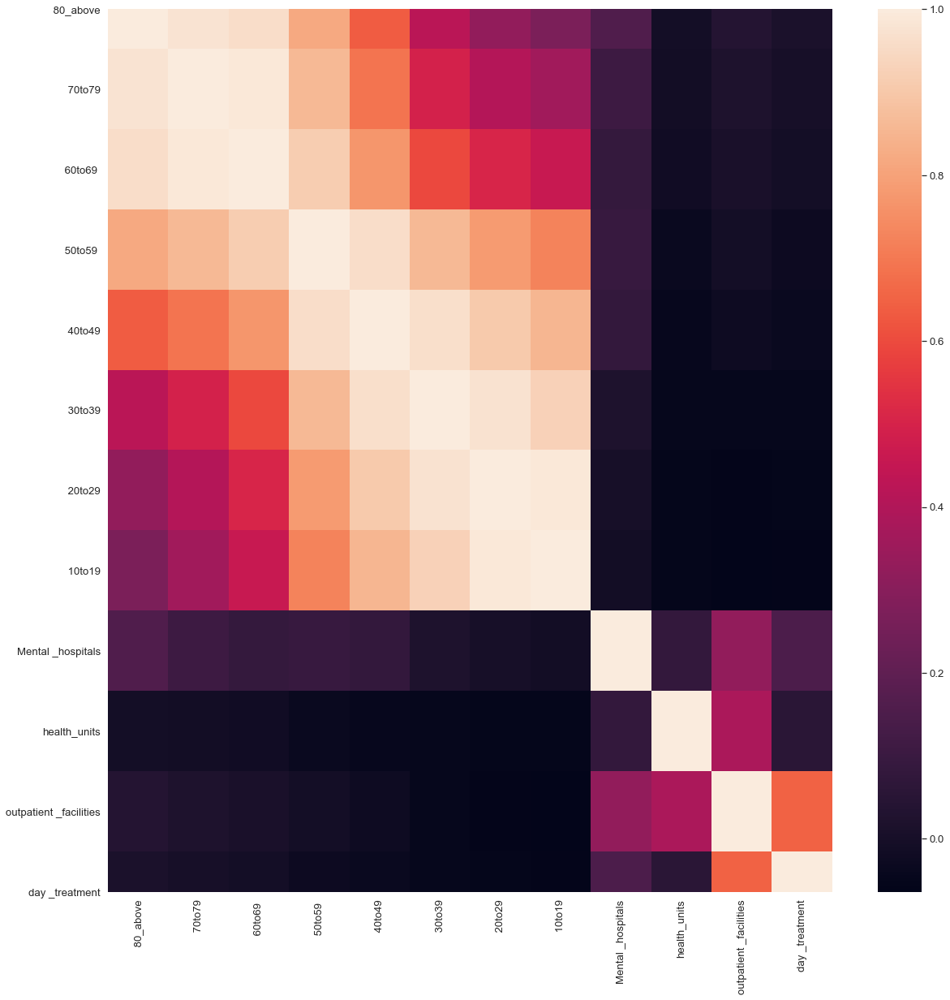

In [107]:
sns.heatmap(df1.corr())

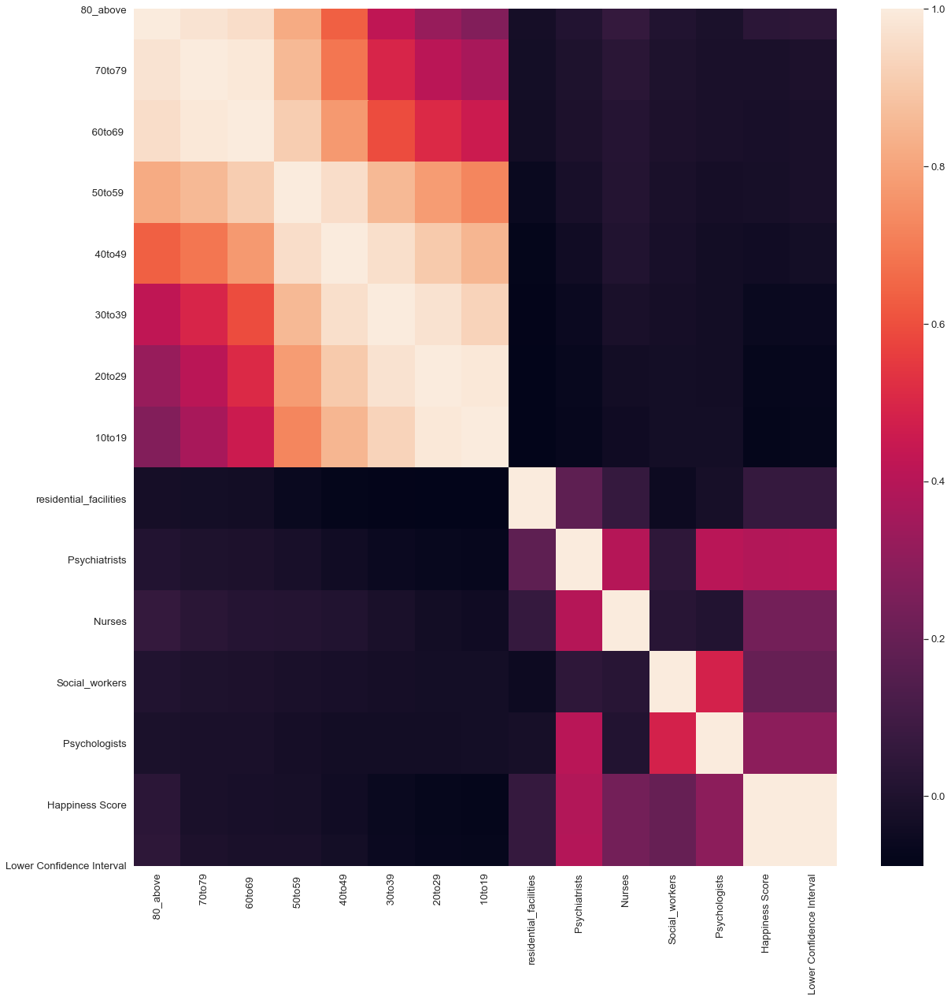

In [108]:
sns.heatmap(df2.corr())

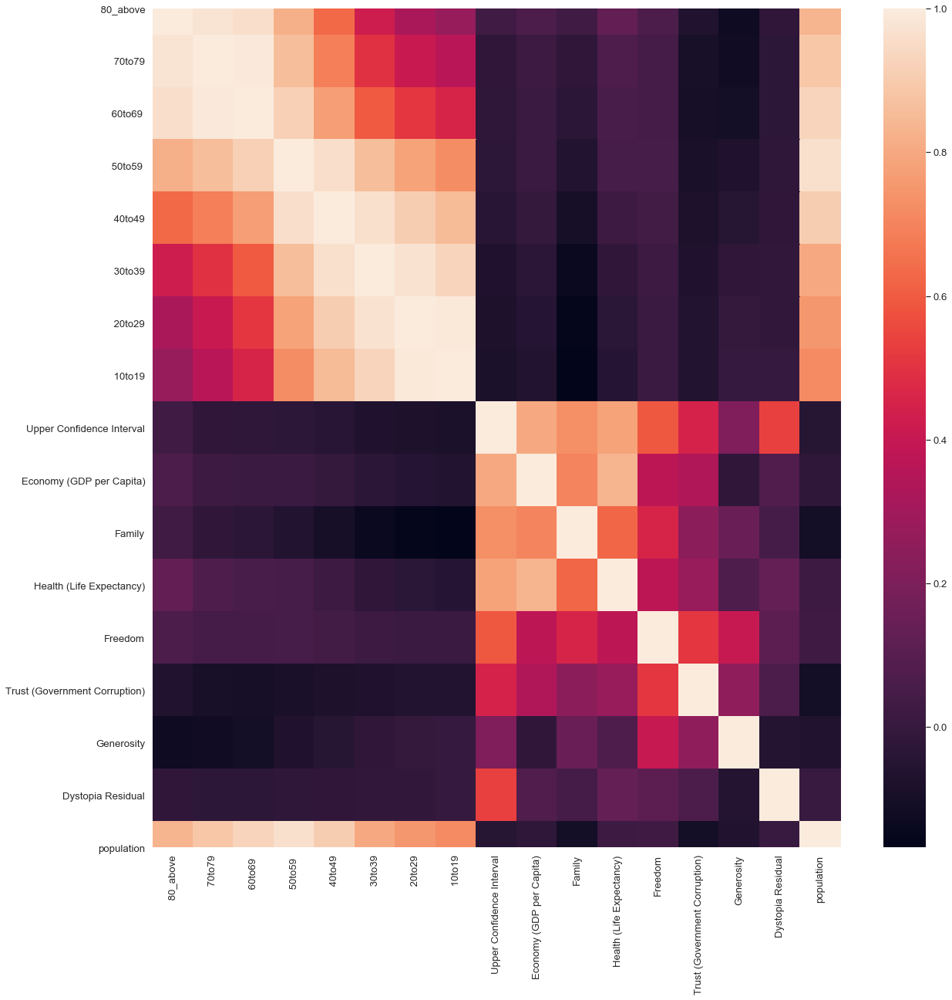

In [109]:
sns.heatmap(df3.corr())

1. The correlation between suicide rates and health facilities is so little.
2. The correlation between health workers & suicide rates is also so little.
3. There is a very high correlation between population & suicide rates.
4. There seems to be some correlation despite it ’s so little between ('Health','Freedom' & economy) & suicide rates.

## 4th Drawing conclusions

By integrating the main points above:
1. Most of the values of the age ranges tends to be distributed near zero as a rate & this is accepted as most of the people tends to live cause of the human nature.
2. Many of the 50_59 age range values tends to show a noticable increase in percentage of high suicide rates(11, 16-20) value ranges.
3. 10_19 age ranges tends to show not a little percent of values in the range nearly (10,17).
4. Most of 70_79 age range values tends to be near zero and this indicates that: this is the lowest age range to commit suicide.
5. 20_29 age range values shows a peak in range of values (near zero- 5, some values in 11, some of values beyond 30"Outliers") indicating that they are the most age range to commit suicide.
6. 40_49 age range values (a little below 10 & near 30) tends to show not a little percent.
7. There is a high rates of suicides on the existance of low number of mental hospitals.
8. As the mental hospitals increase, the rate of suicides in each age range decreases.
9. It is realised that there is outliers that shows an increase of suicide rates on the huge increase of mental hospitals and this may indicate that those mental hospitals was done by the government to face the dpression and suicidal acts. This depression & suicidal acts may mean that there life circumstances are too bad but why do the governments that doesn’t care about its citizens care about providing mental hospitals. This may be explained on going further on our analysis process.
10. Since health units & outpatient facilities role is to care about less mental illness cases so by looking at their statistical visualizations, it was found that on their hige increase, the rate of suicide goes to its minimum range (nearly zero). Since the existance of health units & out patient facilities means a more care about citizen’s mental health, then this indicates that:                                                                                                                
A) as the careness about mental health of citizens increase, the rates of suicide nearly vanishes.                             
B) since these facilities gives an early care about mental issues, then this means that the early care about the mental issues helps effectively in reducing suicidal acts.                                                                                   
11. Health units & outpatient facilities visualized statistics show that, there is some of suicide rates that appear on the existance of a not little number of those facilities & this may indicate as the menatl hospital statistics indicated that those are made by government to face the suicidal acts and mental issues.
12. We can get from the point of not a little number of facilities and the existance of suicide rates that those facilities were made to face the problem of suicidal acts in its beginning or indicates that the country not caring about mental health of its patients.                                                                                                                   
12.1 As most of mental health hospitals and health units are governmental & as existing of not a little number of them show -nearly- absence of suicide rates this may indicates that the existing of a rate of suicides on the existing of not alittle outpatient facilities might be caused by the little existance of governmental facilities in these countries that the citizens tend to commit suicides despite the existance of outpatient facilities.                                                         
12.2 Health units seems to be more effective than outpatient facilities. This can be due to the high expenses of outpatient facilities.                                                                                                                     
13. As the daily treatment increase, the suicide rates decreases & nearly vanishes.
14. There exists some suicide rates despite the existance of a few daily treatment and this phenomenon repeated at all of the age ranges with the -nearly- the same rate.
15. All of the statistical visualizations that draws the relation between Psychiatrists & suicides rates at all ages gives -nearly- the same behavior which shows the existance of a few -but not a little- suicides rates depite the existance of -not high but- a sufficient number of psychiatrists.
16. Also as number 9, all of visualizations of different age ranges show the same behavior, which is there is a surprising increase in the suicide rates after its dissapperance on the high increase of rates of numbers of nurses.
17. As the number of social workers & psychologists increase the rate of suicide rates decrease. Despite that, on the huge increase of psychologists, a surprising -but not high- rates of suicides appear.
18. From the points that showed the relation between workers and facilities of mental health & suicide rates, its noticed that; as the rates of this facilities and workers increases in a huge number, the suicides rates begin to appear again. This might imply that the countries that contribute with that number of workers in the mental field and facilities are trying to develop its citizens mental health or that a wrong methodologies are followed in dealing with mental issues. Making sure of this imply may happen on further analysis on the following years.
19. On going for the visualizations that draw the relation between suicides rates & happiness index. a strange behavior was shown; The countries with near medium and medium happiness score showed high suicide rates in all of age ranges.               
19.1 20_29 age range suicide rates showed a little rates of suicide in the countries of medium happiness score.                 
19.2 The old age_ranges from(50_59 to older) showed a suicide rates which is not little despite the high happiness score that their countries shows.                                                                                                         
20. On the middle level economy and high level economy countries, the suicides rates show an increase more than that of low economy.                                                                                                                       
20.1 This phenomenon dissappears at the high economy at the age range of 20_29.                                                 
20.2 The suicides rates of kids (10_19 age range) shows an increase on the middle economy countries.                           
21. Neglecting the outliers, on the increase of the of number of (family, health(Life expectancy)), the number of suicides tends to show a little but not huge increase.
22. Neglecting the outliers, on the low & high freedom rate, the rates of suicides tend to increase.
23. On increasing the trust(Government corruption), the suicide rates decrease.
24. Neglecting the ouliers, from the statistical visualization between population & suicides rates of different age ranges, there is a positive correlation between them.
25. In general, women tends to show little suicide rates than men.
26. On high -but not so do crowded- population, women tends to show high suicide rate near men rates & the women rates exceeds men rates in the age range 10_19.
27. The outliers of suicides rates in range 10_19 tends to be in females. This may indicate abuses towards this age range of females.
28. Until age range (50_59) women with little freedom tends to commit suicides more than men specially in age ranges (10_19 & 20_29). There is so many other observations but it ’s not inportant as it’s known by default. As an example, men tends to show more suicide rates on low gdp per capita but that may be reasoned easily as the men are -mostly- responsible about funding their families.
29. In age_range 80_above, the highest suicide rate exists in China for the favor of females, followed by france India& Japan by a huge difference for the favor of males, followed by Italy then the rest of the countries goes -nearly- on the same range.
30. In age range 70_79, the same behavior as 80_above age range is shown.
31. In the age range 60_69, Nigeria begin to show a slightly high rate of suicides in the favor of females. But except than that it shows the same behavior as the previous 2 points.
32. In the age range 50_59 Nigeria begin to show a slightly high rate of suicides in the favor of males& india show higher suicide rates than Japan. But except than that it shows the same behavior as the previous points.
33. In the age range 40_49 as the previous point India shows high suicides rates than China in the favor of females.
34. It is noticed that the females suicide rate of China is always than that of India.
35. On the rest of the age ranges, India shows high suicide rates as the previous.                                             
35.1 China suicide rates begins to get lower & lower on going to the lower age ranges.                                         
35.2 On the age ranges 20_29 & 10_19 India tends to show suicidal rates in the favour of females.                               
35.3 The highest rate of female suicides is in the age range 10_19.
36. The correlation between suicide rates and health facilities is so little.
37. The correlation between health workers & suicide rates is also so little.
38. There is a very high correlation between population & suicide rates.
39. There seems to be some correlation despite it ’s so little between ('Health','Freedom' & economy) & suicide rates.

Of course more of analyses can be done on this data & many more info. can be got but I was more focused about what is concerned with Our question. Those results which was drawn to conclusion shall be driven to governmental & specialized Organizations in the mental health.

The Objective of Analysing these data is done. Now we shall go to the last step.

## 5th Preprocessing & model building.

First we will go with the preprocessing step which is the directly previous step to model building. This step is divided into 3 steps:
1. Feature Engineering.
2. Feature Transformation.
3. Feature selection.

#### 1. Feature Engineering
In this process, I will get the best of data by getting new features out of old ones if possible or if needed. Actually the features we have are the ned of features by now. In a furure realeases we can get geospatial feature to solve the problem of the non-existance of some countries at our dataframe. By now all we need is to solve the emerged problem that faces our model. 

The problem that aroused is that age ranges forms labels of the dataframe but we want to get the age range as an input for the model as I wanna specify the estimation of suicide rate for each age range & at the same time I want all of the age range to be Y-values. To solve this problem, there is two ways:         
1. Going on multiple output regression model.
2. Engineering many models with many dataframes with only one of the age ranges as Y(To be predicted).                         

First we are going to move the age range suicide rates to the end of the dataframe

In [111]:
age_range_suic=df.iloc[:,2:10]
df.drop(columns=list(df.columns[2:10]),inplace=True)
df=pd.concat([df,age_range_suic],axis=1)

We can leave this division of dataframe to the end of our project before dividing our dataset to train set and test set

*Since there is nothing that can be done in feature engineering we can go in the 2nd point of preprocessing*

#### 2. Feature transformation

**First, we are going to Work with Categorical features.**

In [112]:
#Getting info about data
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 399 entries, 0 to 398
Data columns (total 30 columns):
Country                          399 non-null object
Sex                              399 non-null object
Mental _hospitals                399 non-null float64
health_units                     399 non-null float64
outpatient _facilities           399 non-null float64
day _treatment                   399 non-null float64
residential_facilities           399 non-null float64
Psychiatrists                    399 non-null float64
Nurses                           399 non-null float64
Social_workers                   399 non-null float64
Psychologists                    399 non-null float64
Happiness Score                  399 non-null float64
Lower Confidence Interval        399 non-null float64
Upper Confidence Interval        399 non-null float64
Economy (GDP per Capita)         399 non-null float64
Family                           399 non-null float64
Health (Life Expectancy)         

As it ’s seen from above, we have two categorical features:('Country' & 'Sex'). Since the two features that we will work with are nominal -not ordinal- features, so we will go with nominal features transformation methods. 

In [113]:
#Going with get_dummies to transfrom 'Sex' label. We will use one hot encoding
df=pd.get_dummies(df,columns=['Sex'],drop_first=True)

since Country feature may cause a lot of features and dummy data existance in model training if it was encode to get_dummies, so I will be using binary encoding as it will be more dimensionaly reduced.

In [114]:
#using binary encoding.
from category_encoders import BinaryEncoder
encoder1= BinaryEncoder(cols=['Country'])
df=encoder1.fit_transform(df)

In [115]:
#Checking data frame after encoding the categorical features
df.head()

,Country_0,Country_1,Country_2,Country_3,Country_4,Country_5,Country_6,Country_7,Country_8,Mental _hospitals,health_units,outpatient _facilities,day _treatment,residential_facilities,Psychiatrists,Nurses,Social_workers,Psychologists,Happiness Score,Lower Confidence Interval,Upper Confidence Interval,Economy (GDP per Capita),Family,Health (Life Expectancy),Freedom,Trust (Government Corruption),Generosity,Dystopia Residual,population,80_above,70to79,60to69,50to59,40to49,30to39,20to29,10to19,Sex_Female,Sex_Male
0,0,0,0,0,0,0,0,0,1,0.003,0.012,0.006,1.070439,0.673053,0.231,0.098,2.612167,0.296,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558,24546,0.039060,0.043560,0.051425,0.089320,0.167112,0.364228,0.613326,0.279713,0,0
1,0,0,0,0,0,0,0,0,1,0.003,0.012,0.006,1.070439,0.673053,0.231,0.098,2.612167,0.296,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558,11909,0.010452,0.004853,0.006762,0.012480,0.027991,0.050976,0.100800,0.052776,1,0
2,0,0,0,0,0,0,0,0,1,0.003,0.012,0.006,1.070439,0.673053,0.231,0.098,2.612167,0.296,3.360,3.288,3.432,0.38227,0.11037,0.17344,0.16430,0.07112,0.31268,2.14558,12636,0.028864,0.038456,0.044296,0.075795,0.138180,0.312570,0.510679,0.222000,0,1
3,0,0,0,0,0,0,0,1,0,0.068,0.068,0.410,1.070439,0.445000,1.471,6.876,1.060000,1.231,4.655,4.546,4.764,0.95530,0.50163,0.73007,0.31866,0.05301,0.16840,1.92816,2549,0.011736,0.015023,0.016860,0.031278,0.032214,0.020740,0.032175,0.021250,0,0
4,0,0,0,0,0,0,0,1,0,0.068,0.068,0.410,1.070439,0.445000,1.471,6.876,1.060000,1.231,4.655,4.546,4.764,0.95530,0.50163,0.73007,0.31866,0.05301,0.16840,1.92816,1259,0.004251,0.004557,0.005577,0.008976,0.009300,0.005440,0.015246,0.014210,1,0


Categorical features are encoded.

**Second we are going to handle the outliers**                                                                                 
Outliers can be detected on visualization or using Z-score.

In [116]:
#Using z-score
np.seterr(divide='ignore', invalid='ignore')
from scipy.stats import zscore
df.apply(zscore)

,Country_0,Country_1,Country_2,Country_3,Country_4,Country_5,Country_6,Country_7,Country_8,Mental _hospitals,health_units,outpatient _facilities,day _treatment,residential_facilities,Psychiatrists,Nurses,Social_workers,Psychologists,Happiness Score,Lower Confidence Interval,Upper Confidence Interval,Economy (GDP per Capita),Family,Health (Life Expectancy),Freedom,Trust (Government Corruption),Generosity,Dystopia Residual,population,80_above,70to79,60to69,50to59,40to49,30to39,20to29,10to19,Sex_Female,Sex_Male
0,NaN,-0.217357,-0.963087,-0.963087,-0.963087,-0.963087,-0.992509,-0.992509,0.992509,-0.315935,-5.767383e-01,-0.771905,0.000000,0.000000,-0.715874,-0.728400,6.703431e-17,-0.444621,-1.752464,-1.718077,-1.785456,-1.379927,-2.519219,-1.657080,-1.446557,-0.605749,0.563217,-0.351023,-0.014352,-0.161139,-0.150256,-0.158210,-0.181113,-0.132746,-0.054942,-0.014284,0.002836,-0.707107,-0.707107
1,NaN,-0.217357,-0.963087,-0.963087,-0.963087,-0.963087,-0.992509,-0.992509,0.992509,-0.315935,-5.767383e-01,-0.771905,0.000000,0.000000,-0.715874,-0.728400,6.703431e-17,-0.444621,-1.752464,-1.718077,-1.785456,-1.379927,-2.519219,-1.657080,-1.446557,-0.605749,0.563217,-0.351023,-0.138491,-0.192474,-0.173292,-0.179204,-0.224903,-0.202739,-0.160658,-0.131211,-0.126491,1.414214,-0.707107
2,NaN,-0.217357,-0.963087,-0.963087,-0.963087,-0.963087,-0.992509,-0.992509,0.992509,-0.315935,-5.767383e-01,-0.771905,0.000000,0.000000,-0.715874,-0.728400,6.703431e-17,-0.444621,-1.752464,-1.718077,-1.785456,-1.379927,-2.519219,-1.657080,-1.446557,-0.605749,0.563217,-0.351023,-0.131350,-0.172307,-0.153294,-0.161561,-0.188821,-0.147302,-0.072376,-0.037702,-0.030054,-0.707107,1.414214
3,NaN,-0.217357,-0.963087,-0.963087,-0.963087,-0.963087,-0.992509,1.007547,-1.007547,-0.227238,-4.617961e-01,-0.531572,0.000000,-0.306636,-0.513424,-0.332410,-2.342962e-01,-0.406064,-0.631711,-0.636113,-0.626612,0.005315,-1.081336,0.777228,-0.390672,-0.764698,-0.527782,-0.766008,-0.230439,-0.191067,-0.167240,-0.174458,-0.214191,-0.200614,-0.170862,-0.146867,-0.144457,-0.707107,-0.707107
4,NaN,-0.217357,-0.963087,-0.963087,-0.963087,-0.963087,-0.992509,1.007547,-1.007547,-0.227238,-4.617961e-01,-0.531572,0.000000,-0.306636,-0.513424,-0.332410,-2.342962e-01,-0.406064,-0.631711,-0.636113,-0.626612,0.005315,-1.081336,0.777228,-0.390672,-0.764698,-0.527782,-0.766008,-0.243111,-0.199266,-0.173468,-0.179761,-0.226900,-0.212143,-0.176025,-0.150729,-0.148469,1.414214,-0.707107
5,NaN,-0.217357,-0.963087,-0.963087,-0.963087,-0.963087,-0.992509,1.007547,-1.007547,-0.227238,-4.617961e-01,-0.531572,0.000000,-0.306636,-0.513424,-0.332410,-2.342962e-01,-0.406064,-0.631711,-0.636113,-0.626612,0.005315,-1.081336,0.777228,-0.390672,-0.764698,-0.527782,-0.766008,-0.242797,-0.196045,-0.169948,-0.177128,-0.219217,-0.205275,-0.172516,-0.150413,-0.152628,-0.707107,1.414214
6,NaN,-0.217357,-0.963087,-0.963087,-0.963087,-0.963087,-0.992509,1.007547,0.992509,-0.254529,-4.617961e-01,-0.746920,0.000000,0.000000,0.000000,0.000000,6.703431e-17,0.000000,0.839548,0.809659,0.868924,0.240673,0.136782,0.287287,-1.133540,0.188120,-1.268524,2.060516,0.056642,-0.154089,-0.139720,-0.140510,-0.154092,-0.105188,-0.056252,-0.084768,-0.112324,-0.707107,-0.707107
7,NaN,-0.217357,-0.963087,-0.963087,-0.963087,-0.963087,-0.992509,1.007547,0.992509,-0.254529,-4.617961e-01,-0.746920,0.000000,0.000000,0.000000,0.000000,6.703431e-17,0.000000,0.839548,0.809659,0.868924,0.240673,0.136782,0.287287,-1.133540,0.188120,-1.268524,2.060516,-0.100543,-0.186117,-0.165914,-0.171649,-0.213130,-0.188265,-0.148186,-0.137066,-0.139910,1.414214,-0.707107
8,NaN,-0.217357,-0.963087,-0.963087,-0.963087,-0.963087,-0.992509,1.007547,0.992509,-0.254529,-4.617961e-01,-0.746920,0.000000,0.000000,0.000000,0.000000,6.703431e-17,0.000000,0.839548,0.809659,0.868924,0.240673,0.136782,0.287287,-1.133540,0.188120,-1.268524,2.060516,-0.098303,-0.172067,-0.150185,-0.150821,-0.172727,-0.133849,-0.086761,-0.102311,-0.128775,-0.707107,1.414214
9,NaN,-0.217357,-0.9630

As it was observed from the data visualizations, the variance of data is large and applying the z-score implies outliers showing that all of the data are outliers, so there is decisions to be taken:
1. There is nothing to be deleted.
2. Not to use a ML model that is affected by outliers.

**Third we are going to split the data into train and test sets**

In [471]:
#Setting x & y
x=df.drop(columns=list(df.columns[29:37]))
y=df.iloc[:,29:37]

In [472]:
#Splitting data into train & test set
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test= train_test_split(x,y,test_size=0.2,random_state=27)

We needn’t any dealing with imbalanced classes since we have only two categories & we know that they are balanced.

**Going on feature scaling**

In [473]:
#We  will make it simple and use minmax scaler
from sklearn.preprocessing import MinMaxScaler
scaler=MinMaxScaler() 
scale=scaler.fit(x_train)
x_train=scale.transform(x_train)
x_test=scale.transform(x_test)

**Feature selection**

As the features that is coreelated with eacg suicide rates for different age ranges will differ (According to anova), so we will see the best features for each suicide rate age range and get the most correlated with all of the suicide rates to unify the model usage of features on our website for all of the age ranges.

In [474]:
#Importing important libraries
from sklearn.feature_selection import f_regression
from sklearn.feature_selection import SelectKBest

In [488]:
#Definging selection algorithm & the number of features to be selected. 
selector = SelectKBest(k=10, score_func=f_regression)

Now we will go on a loop that prints the best features for each age range

In [489]:
for age_range in y:
    selector.fit(x,y[age_range])
    selected_features_idx = selector.get_support(indices=True)
    all_features = x.columns
    selected_features = all_features[selected_features_idx]
    print('The best features for'+age_range+' is: ')
    print(list(selected_features))

The best features for 80_above is: 
['Country_2', 'Country_4', 'Country_5', 'Country_6', 'Mental _hospitals', 'Economy (GDP per Capita)', 'Health (Life Expectancy)', 'Freedom', 'Generosity', 'population']
The best features for 70to79 is: 
['Country_2', 'Country_4', 'Country_5', 'Country_6', 'Country_8', 'Mental _hospitals', 'Health (Life Expectancy)', 'Trust (Government Corruption)', 'Generosity', 'population']
The best features for 60to69  is: 
['Country_2', 'Country_4', 'Country_5', 'Country_6', 'Country_8', 'Mental _hospitals', 'Health (Life Expectancy)', 'Trust (Government Corruption)', 'Generosity', 'population']
The best features for 50to59  is: 
['Country_2', 'Country_4', 'Country_6', 'Country_8', 'Mental _hospitals', 'residential_facilities', 'Trust (Government Corruption)', 'Generosity', 'population', 'Sex_Female']
The best features for 40to49 is: 
['Country_2', 'Country_4', 'Country_6', 'Country_8', 'Mental _hospitals', 'residential_facilities', 'Family', 'Trust (Government C

From the result above we can see that the best features for the model are: (Country, population, Mental hospitals, residential facilities, Trust (Government Corruption), family).

Now we will go with making a new x dataframe, splitting & scaling again.

In [504]:
#Reassigning x values
x=pd.concat([x.iloc[:,:10],x.iloc[:,13],x.iloc[:,22],x.iloc[:,25],x.iloc[:,28]],axis=1)

In [506]:
x

,Country_0,Country_1,Country_2,Country_3,Country_4,Country_5,Country_6,Country_7,Country_8,Mental _hospitals,residential_facilities,Family,Trust (Government Corruption),population
0,0,0,0,0,0,0,0,0,1,0.003000,0.673053,0.11037,0.07112,24546
1,0,0,0,0,0,0,0,0,1,0.003000,0.673053,0.11037,0.07112,11909
2,0,0,0,0,0,0,0,0,1,0.003000,0.673053,0.11037,0.07112,12636
3,0,0,0,0,0,0,0,1,0,0.068000,0.445000,0.50163,0.05301,2549
4,0,0,0,0,0,0,0,1,0,0.068000,0.445000,0.50163,0.05301,1259
5,0,0,0,0,0,0,0,1,0,0.068000,0.445000,0.50163,0.05301,1291
6,0,0,0,0,0,0,0,1,1,0.048000,0.673053,0.83309,0.16157,31773
7,0,0,0,0,0,0,0,1,1,0.048000,0.673053,0.83309,0.16157,15772
8,0,0,0,0,0,0,0,1,1,0.048000,0.673053,0.83309,0.16157,16000
9,0,0,0,0,0,0,1,0,0,0.011000,0.014000,0.66366,0.08434,18981


**Since we have different y-values to go with in our model, so we will go with splitting and scaling on each y-value (Suicide_age_range).**

In [508]:
#Splitting
x_train, x_test, y_train, y_test= train_test_split(x,y.iloc[:,0],test_size=0.2,random_state=27)
#Scaling
scale=scaler.fit(x_train)
x_train=scale.transform(x_train)
x_test=scale.transform(x_test)

Getting the model scores for all of the suicide_rate age ranges to decide the best model for each.

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR 
from sklearn.tree import DecisionTreeRegressor
from xgboost import XGBRegressor

In [522]:
for age_ranges in y:
    x_train, x_test, y_train, y_test= train_test_split(x,y[age_ranges],test_size=0.2,random_state=27)
    scale=scaler.fit(x_train)
    x_train=scale.transform(x_train)
    x_test=scale.transform(x_test)
    model=RandomForestRegressor(n_estimators=1000,random_state=27)
    model.fit(x_train,y_train)
    y_predict=model.predict(x_test)
    score= model.score(x_test,y_test)
    print('Model score for RandomForest in ',age_ranges,' is: ',score)
    model=DecisionTreeRegressor(random_state=27)
    model.fit(x_train,y_train)
    y_predict=model.predict(x_test)
    score= model.score(x_test,y_test)
    print('Model score for DecisionTree in ',age_ranges,' is: ',score)
    model = SVR()
    model.fit(x_train,y_train)
    y_predict=model.predict(x_test)
    score= model.score(x_test,y_test)
    print('Model score for SVR in ',age_ranges,' is: ',score)
    model = XGBRegressor(n_estimators = 1000)
    model.fit(x_train,y_train)
    y_predict=model.predict(x_test)
    score= model.score(x_test,y_test)
    print('Model score for XGBRegressor in ',age_ranges,' is: ',score)
    print('...................................................................................................')

Model score for RandomForest in   80_above  is:  0.8051165890214526
Model score for DecisionTree in   80_above  is:  0.9313890866991477
Model score for SVR in   80_above  is:  0.20946767632828744
Model score for XGBRegressor in   80_above  is:  0.9475168033654251
...................................................................................................
Model score for RandomForest in   70to79  is:  0.9422965526011937
Model score for DecisionTree in   70to79  is:  0.8272808414136359
Model score for SVR in   70to79  is:  0.14582546732334734
Model score for XGBRegressor in   70to79  is:  0.8798711606892615
...................................................................................................
Model score for RandomForest in   60to69   is:  0.9125601231194269
Model score for DecisionTree in   60to69   is:  0.8931165386300375
Model score for SVR in   60to69   is:  0.10407979509437304
Model score for XGBRegressor in   60to69   is:  0.94173033037832
......................

As it’s seen from above:
1. The best model for the age range 80_above is : XGBRegressor
2. The best model for the age range 70_79 is : RandomForest
3. The best model for the age range 60_69 is : XGBRegressor
4. The best model for the age range 50_59 is : RandomForest
5. The best model for the age range 40_49 is : RandomForest
6. The best model for the age range 30_39 is : RandomForest
7. The best model for the age range 20_29 is : XGBRegressor
7. The best model for the age range 10_19 is : DecisionTree.

**So going for training & model making for each suicide rate age range with the best algorithm for each.**

**80_above Model**

In [535]:
x_train, x_test, y_train, y_test= train_test_split(x,y.iloc[:,0],test_size=0.2,random_state=27)
scale=scaler.fit(x_train)
x_train=scale.transform(x_train)
x_test=scale.transform(x_test)
model_80= XGBRegressor(n_estimators = 1000)
model_80.fit(x_train,y_train)
y_predict=model_80.predict(x_test)
model_80.score(x_test,y_test)

0.9475168033654251

**70_79 Model**

In [536]:
x_train, x_test, y_train, y_test= train_test_split(x,y.iloc[:,1],test_size=0.2,random_state=27)
scale=scaler.fit(x_train)
x_train=scale.transform(x_train)
x_test=scale.transform(x_test)
model_70s=RandomForestRegressor(n_estimators=1000,random_state=27)
model_70s.fit(x_train,y_train)
y_predict=model_70s.predict(x_test)
model_70s.score(x_test,y_test)

0.9422965526011937

**60_69 Model**

In [539]:
x_train, x_test, y_train, y_test= train_test_split(x,y.iloc[:,2],test_size=0.2,random_state=27)
scale=scaler.fit(x_train)
x_train=scale.transform(x_train)
x_test=scale.transform(x_test)
model_60s= XGBRegressor(n_estimators = 1000)
model_60s.fit(x_train,y_train)
y_predict=model_60s.predict(x_test)
model_60s.score(x_test,y_test)

0.94173033037832

**50_59 Model**

In [541]:
x_train, x_test, y_train, y_test= train_test_split(x,y.iloc[:,3],test_size=0.2,random_state=27)
scale=scaler.fit(x_train)
x_train=scale.transform(x_train)
x_test=scale.transform(x_test)
model_50s=RandomForestRegressor(n_estimators=1000,random_state=27)
model_50s.fit(x_train,y_train)
y_predict=model_50s.predict(x_test)
model_50s.score(x_test,y_test)

0.8220508414884735

**40_49 Model**

In [543]:
x_train, x_test, y_train, y_test= train_test_split(x,y.iloc[:,4],test_size=0.2,random_state=27)
scale=scaler.fit(x_train)
x_train=scale.transform(x_train)
x_test=scale.transform(x_test)
model_40s=RandomForestRegressor(n_estimators=1000,random_state=27)
model_40s.fit(x_train,y_train)
y_predict=model_40s.predict(x_test)
model_40s.score(x_test,y_test)

0.8101159682613581

**30_39 Model**

In [544]:
x_train, x_test, y_train, y_test= train_test_split(x,y.iloc[:,5],test_size=0.2,random_state=27)
scale=scaler.fit(x_train)
x_train=scale.transform(x_train)
x_test=scale.transform(x_test)
model_30s=RandomForestRegressor(n_estimators=1000,random_state=27)
model_30s.fit(x_train,y_train)
y_predict=model_30s.predict(x_test)
model_30s.score(x_test,y_test)

0.8843200149682615

**20_29 Model**

In [545]:
x_train, x_test, y_train, y_test= train_test_split(x,y.iloc[:,6],test_size=0.2,random_state=27)
scale=scaler.fit(x_train)
x_train=scale.transform(x_train)
x_test=scale.transform(x_test)
model_20s= XGBRegressor(n_estimators = 1000)
model_20s.fit(x_train,y_train)
y_predict=model_20s.predict(x_test)
model_20s.score(x_test,y_test)

0.9897816986051677

**10_19 Model**

In [547]:
x_train, x_test, y_train, y_test= train_test_split(x,y.iloc[:,7],test_size=0.2,random_state=27)
scale=scaler.fit(x_train)
x_train=scale.transform(x_train)
x_test=scale.transform(x_test)
model_teens=DecisionTreeRegressor(random_state=27)
model_teens.fit(x_train,y_train)
y_predict=model_teens.predict(x_test)
model_teens.score(x_test,y_test)

0.8194593183695273

The last step to be done is to save the models.

In [548]:
import joblib

In [549]:
joblib.dump(model_80,'model_80.pkl')
joblib.dump(model_70s,'model_70s.pkl')
joblib.dump(model_60s,'model_60s.pkl')
joblib.dump(model_50s,'model_50s.pkl')
joblib.dump(model_40s,'model_40s.pkl')
joblib.dump(model_30s,'model_30s.pkl')
joblib.dump(model_20s,'model_20s.pkl')
joblib.dump(model_teens,'model_teens.pkl')

['model_teens.pkl']